# Applie Statistics Project 

Workflow

1. Processing  **OK**

    • Focus on last 2 or 5 years

    • Consider only the pool where all the zones are present

2. Exploratory Data Analysis **OK**

    • Treat hours separately (so consider daily time series)

    • Look at similarities within day type, month

3. Functional Data Analysis **OK**

    • Smoothing  (we have to do it for day)

    • Functional Principal Component Analysis  
    
    • K-means

4. Correlation with external variables (Gas price, load and renewable generation forecast)

5. Functional (Auto)Regression models



In [1]:
#import libraries 

import pandas as pd
pd.options.mode.chained_assignment = None

import gzip
import pickle
from io import BytesIO
import plotly.express as px
import matplotlib.pyplot as plt
from math import sqrt
import seaborn as sns
from datetime import datetime
from tqdm.notebook import tqdm
import os
from os.path import join
from ydata_profiling import ProfileReport

import numpy as np
from numpy.polynomial.polynomial import Polynomial

from scipy.stats import gaussian_kde
import statsmodels.api as sm

#GP imputation 
from sklearn.metrics import mean_squared_error
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, DotProduct, RationalQuadratic, ExpSineSquared, Matern
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.model_selection import train_test_split

from itertools import product


#functional data analysis
import skfda
from skfda.exploratory.visualization import FPCAPlot
from skfda.preprocessing.dim_reduction import FPCA
from skfda.representation.basis import (
    BSplineBasis,
    FourierBasis,
    MonomialBasis,

)
from skfda.representation.grid import FDataGrid

In [5]:
#helper function definition 

#function to convert data and time formats and create a column that contain both values in datetime format
def converti_data_ora(row):
    data_str = str(row['Data'])
    ora_str = str(row['Ora']-1)  # -1 because the range time is from 0 to 23 so ex. hour 1 corresponds to 00:00
    data_ora_str = data_str[:4] + '-' + data_str[4:6] + '-' + data_str[6:] + ' ' + ora_str + ':00:00'
    return datetime.strptime(data_ora_str, '%Y-%m-%d %H:%M:%S')


# Polynomial smoothing
def smooth_series(series, degree=2):
    y = series.values
    mask = ~np.isnan(y)
    coefs = Polynomial.fit(x[mask], y[mask], deg=degree)
    return coefs(x)

# LOESS smoothing 
def apply_loess(series, frac=0.3):
    lowess = sm.nonparametric.lowess # LOESS smoothing
    smoothed_values = lowess(series, series.index, frac=frac, return_sorted=False) # The series index is numeric and represents hours
    return smoothed_values

## Processing and Exploration

### Data Loading

barta loading

In [ ]:
'''
####  using ts_df.pkl.gz 

YEAR = 2023
path = r'C:\Users\bartama\Desktop\PoliMi Stuff\Applied Statistics\Data\dataa\\'
file = 'ts_df.pkl.gz'

with gzip.open(path+file, 'rb') as f:
    loaded_df = pd.read_pickle(f)

# Getting Values from a specific year that can be choose with YEAR constant

loaded_df['Data'] = pd.to_datetime(loaded_df['Data'], format='%Y%m%d')
loaded_df = loaded_df.loc[loaded_df['Data'].dt.year == YEAR,:]
'''

Luca loading 

In [12]:
market = 'MGP'
dataset = 'DomandaOfferta'
date_range = pd.date_range(start='2022-01-01', end='2023-12-31')

df_list = []

for date in tqdm(date_range):   #iterate in the range specified before 
    
    date = date.strftime('%Y%m%d') #ex. 2019-01-01 --> 20190101
    file_path = join('data', market +'_'+ dataset, str(date) + market + dataset + '.xml') #file path = data/MGP_DomandaOfferta/20190101DomandaOfferta
    
    if not(os.path.exists(file_path)):      #check correct path existance
        print(f"{file_path} not found")
    else:
        df = pd.read_xml(file_path, xpath=f'./{dataset}')  #read xml file and w in df 
    df_list.append(df)

loaded_df = pd.concat(df_list, ignore_index=True)  #create a unique dataframe 
loaded_df

  0%|          | 0/730 [00:00<?, ?it/s]

,Data,Ora,Mercato,ZonaMercato,PrezzoZonale,Quantita,Prezzo,Tipo
0,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,70000.000,3000.00,OFF
1,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,1.200,1500.00,OFF
2,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,125.000,1000.00,OFF
3,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,101.000,909.32,OFF
4,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,105.000,905.62,OFF
...,...,...,...,...,...,...,...,...
6153398,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID
6153399,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID
6153400,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID
6153401,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID


In [13]:
#saving loaded_df in a pickle file in order to use it in the future without downloading the data again

with open('loaded_df.pickle', 'wb') as f:
    pickle.dump(loaded_df, f)  


In [14]:
# Per Pickle
with open('loaded_df.pickle', 'rb') as f:
    loaded_df = pickle.load(f)

### Exploration 

In [15]:
loaded_df

,Data,Ora,Mercato,ZonaMercato,PrezzoZonale,Quantita,Prezzo,Tipo
0,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,70000.000,3000.00,OFF
1,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,1.200,1500.00,OFF
2,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,125.000,1000.00,OFF
3,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,101.000,909.32,OFF
4,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,105.000,905.62,OFF
...,...,...,...,...,...,...,...,...
6153398,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID
6153399,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID
6153400,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID
6153401,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID


In [16]:
loaded_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6153403 entries, 0 to 6153402
Data columns (total 8 columns):
 #   Column        Dtype  
---  ------        -----  
 0   Data          int64  
 1   Ora           int64  
 2   Mercato       object 
 3   ZonaMercato   object 
 4   PrezzoZonale  float64
 5   Quantita      float64
 6   Prezzo        float64
 7   Tipo          object 
dtypes: float64(3), int64(2), object(3)
memory usage: 375.6+ MB


In [ ]:

PROFILE = ProfileReport(loaded_df, title=" Profiling Report")
PROFILE


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#saving the profile report in a html file in order to visualize it in a more user-friendly way 
PROFILE.to_file("profile_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#load the saved profile report
PROFILE = ProfileReport.load("profile_report.html")

### Processing

In [17]:
loaded_df

,Data,Ora,Mercato,ZonaMercato,PrezzoZonale,Quantita,Prezzo,Tipo
0,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,70000.000,3000.00,OFF
1,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,1.200,1500.00,OFF
2,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,125.000,1000.00,OFF
3,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,101.000,909.32,OFF
4,20220101,1,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;CORS;FR...,170.28,105.000,905.62,OFF
...,...,...,...,...,...,...,...,...
6153398,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID
6153399,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID
6153400,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID
6153401,20231231,24,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID


In [18]:
loaded_df.Ora.value_counts()

Ora
12    277885
15    275484
14    275128
13    274633
11    272485
16    271818
17    267443
10    266593
19    262382
20    262334
18    262015
21    260791
9     258541
22    258038
23    253863
24    250185
8     249648
7     239650
1     236899
3     236107
6     235891
2     235352
5     235077
4     234618
25       543
Name: count, dtype: int64

In [19]:
# delete rows where hour is 25
loaded_df = loaded_df[loaded_df.Ora != 25]

In [20]:
#select only the pool where all zanes are present so the situation in which all zones collaborate in a unique market 

loaded_df = loaded_df.loc[loaded_df.ZonaMercato=='CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CORS;FRAN;GREC;SLOV;SVIZ;MALT;COUP;MONT;',:]


In [21]:
loaded_df['Data'] = pd.to_datetime(loaded_df['Data'], format='%Y%m%d').dt.strftime('%Y-%m-%d')
loaded_df['Ora'] = (loaded_df['Ora'] - 1).astype(str).str.zfill(2) + ':00:00'

loaded_df['DataOra'] = pd.to_datetime(loaded_df['Data'] + ' ' + loaded_df['Ora'])

In [22]:
# rename columns to English

column_mapping = {'Data': 'Day', 'Ora': 'Hour',"Mercato":"Market", 'ZonaMercato': 'MarketArea', 'PrezzoZonale': 'ZonalPrice', 'Quantita': 'Quantity', 'Prezzo': 'Price', 'Tipo': 'Type', "DataOra": "Date"}


loaded_df.rename(columns=column_mapping, inplace=True)

In [23]:
# looking for duplicates rows
duplicate_row = loaded_df[loaded_df.duplicated()]
duplicate_row.value_counts()


Series([], Name: count, dtype: int64)

In [24]:
loaded_df

,Day,Hour,Market,MarketArea,ZonalPrice,Quantity,Price,Type,Date
2525,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,70000.000,3000.00,OFF,2022-01-01 07:00:00
2526,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,1.200,1500.00,OFF,2022-01-01 07:00:00
2527,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,195.000,1000.00,OFF,2022-01-01 07:00:00
2528,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,101.000,909.32,OFF,2022-01-01 07:00:00
2529,2022-01-01,07:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,99.99,105.000,905.62,OFF,2022-01-01 07:00:00
...,...,...,...,...,...,...,...,...,...
6153398,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,0.007,0.00,BID,2023-12-31 23:00:00
6153399,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,50.000,-0.27,BID,2023-12-31 23:00:00
6153400,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,9.000,-3.01,BID,2023-12-31 23:00:00
6153401,2023-12-31,23:00:00,MGP,CALA;CNOR;CSUD;NORD;SARD;SICI;SUD;AUST;COAC;CO...,106.12,54.000,-100.00,BID,2023-12-31 23:00:00


In [25]:
# saved datafram preprocess_df in a pickle file in order to use it in the future without reprocessing the data
with open('preprocess_df.pickle', 'wb') as f:
    pickle.dump(loaded_df, f)  

In [26]:
#load the saved preprocess_df
with open('preprocess_df.pickle', 'rb') as f:
    loaded_df = pickle.load(f)

In [27]:
columns_wanted = ['Date', 'ZonalPrice', 'Quantity','Price']

## BID

In [28]:


bid = loaded_df.loc[loaded_df.Type == "BID",columns_wanted]
bid_df = bid.copy()
bid.Price = bid.Price *-1 ## for bid prices, take the negative of it
bid = bid.sort_values(by=['Price']).reset_index(drop = True) # sort in ascending way
bid['Cumulative Quantity'] = bid.Quantity.cumsum()


ask = loaded_df.loc[loaded_df.Type == "OFF",columns_wanted]
ask_df = ask.copy()
ask = ask.sort_values(by=['Price']).reset_index(drop = True)
ask['Cumulative Quantity'] = ask.Quantity.cumsum()

In [29]:
#salva bid_df e ask_df in un file pickle per utilizzarli in futuro senza doverli ricalcolare
with open('bid_df.pickle', 'wb') as f:
    pickle.dump(bid_df, f)

with open('ask_df.pickle', 'wb') as f:
    pickle.dump(ask_df, f)

In [ ]:
#load the saved preprocess_df
with open('bid_df.pickle', 'rb') as f:
    bid_df = pickle.load(f)

#load the saved preprocess_df
with open('ask_df.pickle', 'rb') as f:
    ask_df = pickle.load(f)

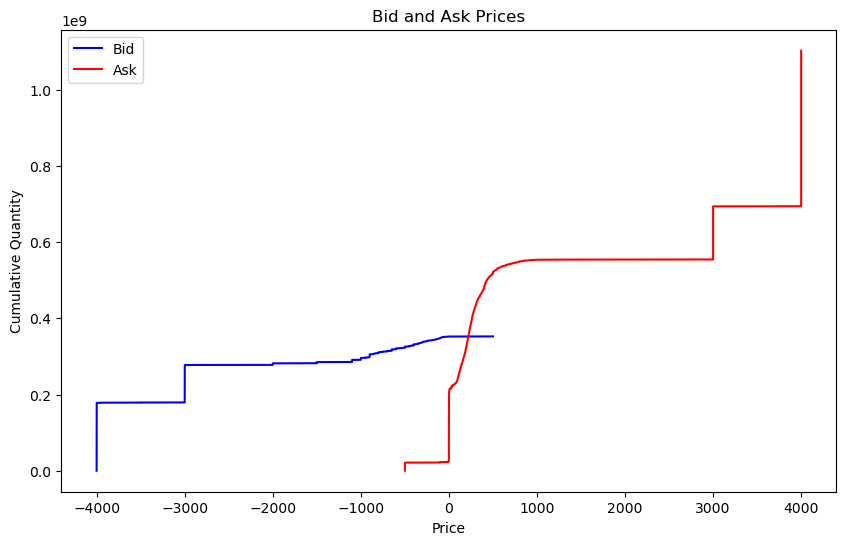

In [30]:
#plot similarities between bid and ask prices
plt.figure(figsize=(10,6))
plt.plot(bid['Price'], bid['Cumulative Quantity'], label='Bid', color='blue')
plt.plot(ask['Price'], ask['Cumulative Quantity'], label='Ask', color='red')
plt.xlabel('Price')
plt.ylabel('Cumulative Quantity')
plt.title('Bid and Ask Prices')
plt.legend()
plt.show()

### BID

In [31]:
bid_df

,Date,ZonalPrice,Quantity,Price
2840,2022-01-01 07:00:00,99.99,18775.156,3000.00
2841,2022-01-01 07:00:00,99.99,7.114,2999.00
2842,2022-01-01 07:00:00,99.99,2.526,2000.00
2843,2022-01-01 07:00:00,99.99,162.000,1000.00
2844,2022-01-01 07:00:00,99.99,267.513,800.00
...,...,...,...,...
6153398,2023-12-31 23:00:00,106.12,0.007,0.00
6153399,2023-12-31 23:00:00,106.12,50.000,-0.27
6153400,2023-12-31 23:00:00,106.12,9.000,-3.01
6153401,2023-12-31 23:00:00,106.12,54.000,-100.00


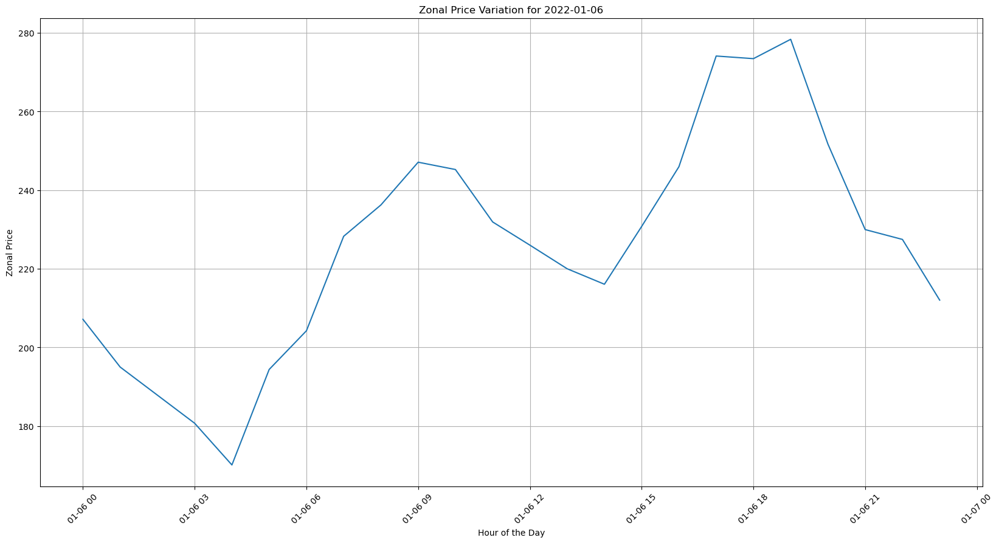

In [32]:

target_date = '2022-01-06'

target_day_data = bid_df[bid_df['Date'].dt.date == pd.to_datetime(target_date).date()]

plt.figure(figsize=(20, 10))
plt.plot(target_day_data['Date'], target_day_data['ZonalPrice'])
plt.xlabel('Hour of the Day')
plt.ylabel('Zonal Price')
plt.title(f'Zonal Price Variation for {target_date}')
plt.grid(True)
plt.xticks(rotation=45) 
plt.show()





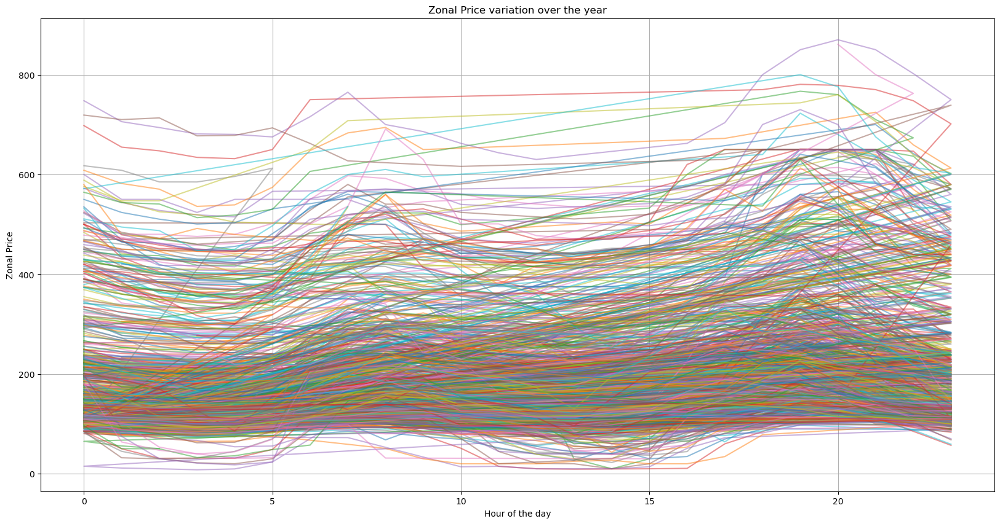

In [33]:
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

plt.figure(figsize=(20, 10))

for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    plt.plot(daily_data['Hour'], daily_data['ZonalPrice'], label=f'Day {day}', alpha=0.5)

plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Zonal Price variation over the year')
plt.grid(True)
plt.show()


/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


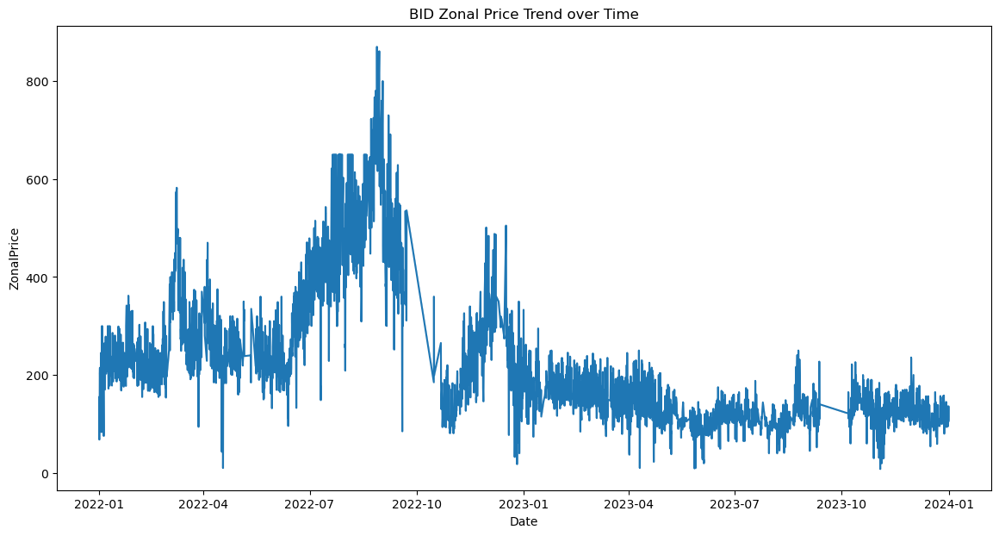

In [34]:
plt.figure(figsize=(14, 7))
sns.lineplot(x='Date', y='ZonalPrice', data=bid_df)
plt.title('BID Zonal Price Trend over Time')
plt.show()

In [35]:
# Extract hours and days of the week
bid_df['hour'] = bid_df['Date'].dt.hour
bid_df['day_week'] = bid_df['Date'].dt.dayofweek

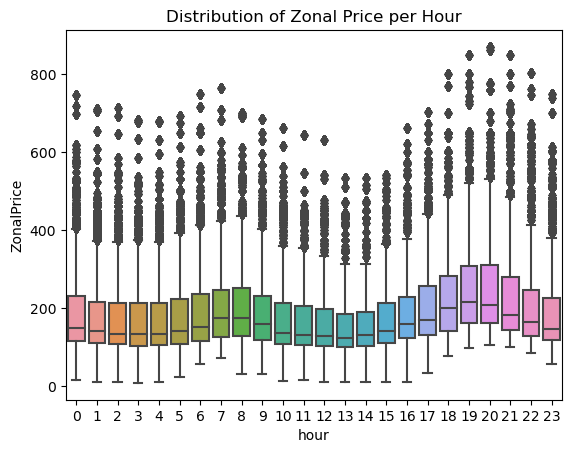

In [36]:
# Analysis for hours
sns.boxplot(x='hour', y='ZonalPrice', data=bid_df)
plt.title('Distribution of Zonal Price per Hour')
plt.show()

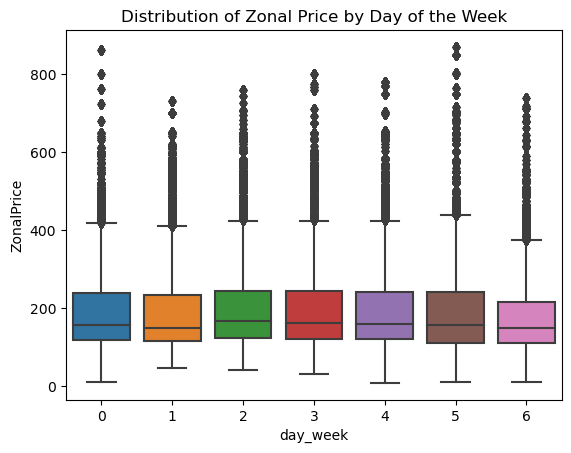

In [37]:
# Analysis by day of the week
sns.boxplot(x='day_week', y='ZonalPrice', data=bid_df)
plt.title('Distribution of Zonal Price by Day of the Week')
plt.show()

In [38]:
bid_df

,Date,ZonalPrice,Quantity,Price,Hour,DayOfYear,hour,day_week
2840,2022-01-01 07:00:00,99.99,18775.156,3000.00,7,1,7,5
2841,2022-01-01 07:00:00,99.99,7.114,2999.00,7,1,7,5
2842,2022-01-01 07:00:00,99.99,2.526,2000.00,7,1,7,5
2843,2022-01-01 07:00:00,99.99,162.000,1000.00,7,1,7,5
2844,2022-01-01 07:00:00,99.99,267.513,800.00,7,1,7,5
...,...,...,...,...,...,...,...,...
6153398,2023-12-31 23:00:00,106.12,0.007,0.00,23,365,23,6
6153399,2023-12-31 23:00:00,106.12,50.000,-0.27,23,365,23,6
6153400,2023-12-31 23:00:00,106.12,9.000,-3.01,23,365,23,6
6153401,2023-12-31 23:00:00,106.12,54.000,-100.00,23,365,23,6


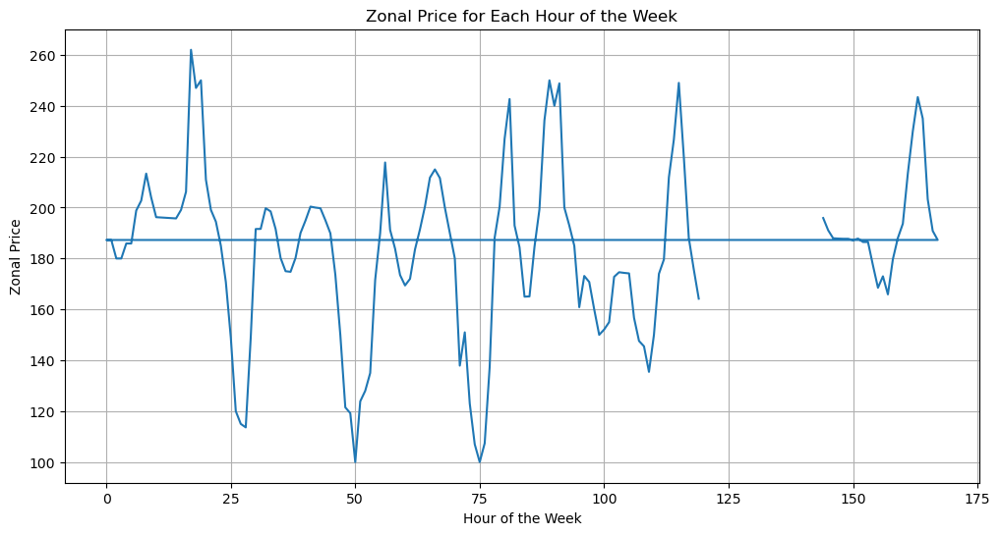

In [39]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Filter data for a single week
start_date = '2023-01-01'
end_date = '2023-01-07'
week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] < end_date)]

# Create a continuous function for zonal prices for each hour of the week
plt.figure(figsize=(12, 6))

# Plot zonal price against hours for the entire week
plt.plot(week_data['Hour'] + ((week_data['Date'].dt.dayofweek % 7) * 24), week_data['ZonalPrice'])

plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of the Week')

plt.grid(True)
plt.show()



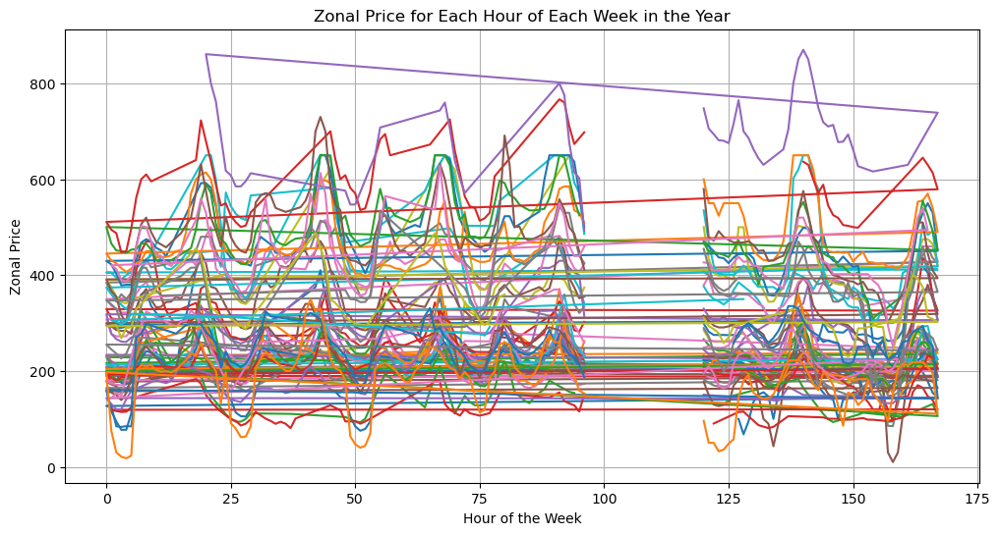

In [40]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Create an empty figure
plt.figure(figsize=(12, 6))

# Iterate over each week of the year
for week in range(1, 53):
    # Filter data for the current week
    start_date = pd.Timestamp(year=bid_df['Date'].iloc[0].year, month=1, day=1) + pd.DateOffset(weeks=(week - 1))
    end_date = start_date + pd.DateOffset(days=6)
    week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] <= end_date)]

    # Plot the zonal price against hours for the entire week
    plt.plot(week_data['Hour'] + ((week_data['Date'].dt.dayofweek % 7) * 24), week_data['ZonalPrice'], label=f'Week {week}')

# Add labels and title
plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of Each Week in the Year')


# Show grid
plt.grid(True)

# Show plot
plt.show()


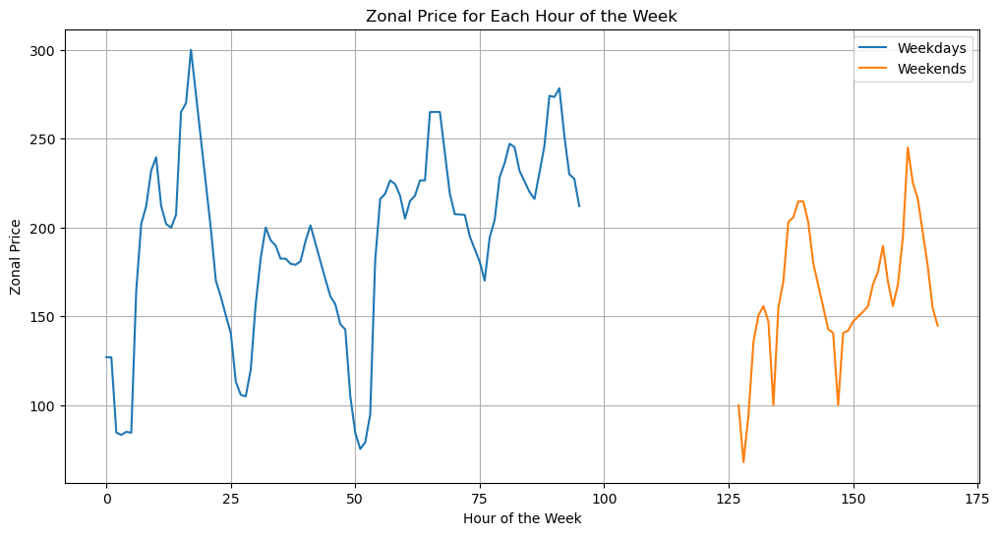

In [41]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Filter data for a single week
start_date = '2022-01-01'
end_date = '2022-01-07'
week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] < end_date)]

# Divide the week data into two parts: Monday to Friday and Saturday to Sunday
weekend_mask = (week_data['Date'].dt.dayofweek >= 5)  # Saturday and Sunday
weekday_mask = ~weekend_mask  # Monday to Friday

weekend_data = week_data[weekend_mask]
weekday_data = week_data[weekday_mask]

# Plot the zonal price against hours for each part of the week
plt.figure(figsize=(12, 6))

plt.plot(weekday_data['Hour'] + (weekday_data['Date'].dt.dayofweek * 24), weekday_data['ZonalPrice'], label='Weekdays')
plt.plot(weekend_data['Hour'] + (weekend_data['Date'].dt.dayofweek * 24), weekend_data['ZonalPrice'], label='Weekends')

plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of the Week')

plt.legend()
plt.grid(True)
plt.show()


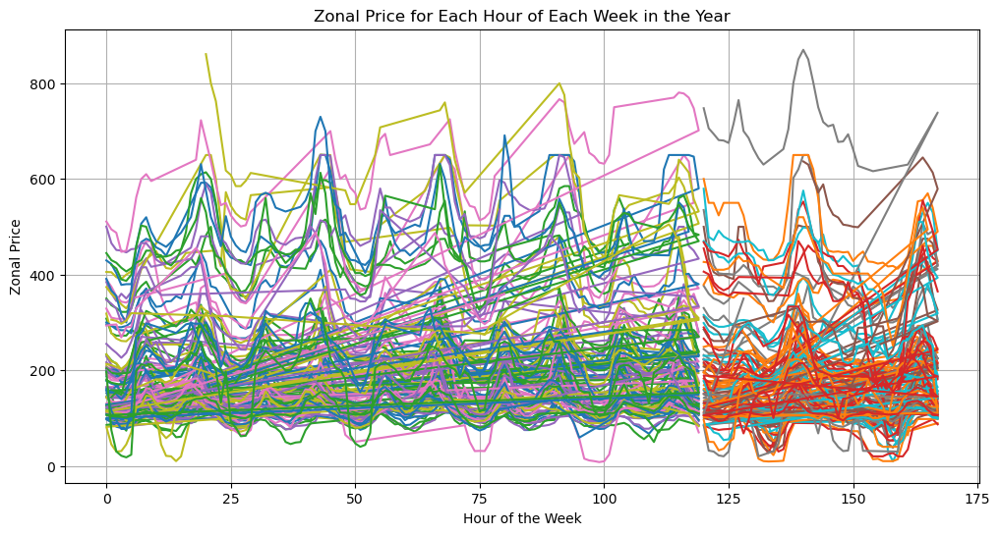

In [42]:
# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Create an empty figure
plt.figure(figsize=(12, 6))

# Iterate over each week of the year
for week in range(1, 53):
    # Filter data for the current week
    week_data = bid_df[bid_df['Date'].dt.isocalendar().week == week]

    # Divide the week data into two parts: Monday to Friday and Saturday to Sunday
    weekend_mask = (week_data['Date'].dt.dayofweek >= 5)  # Saturday and Sunday
    weekday_mask = ~weekend_mask  # Monday to Friday

    weekend_data = week_data[weekend_mask]
    weekday_data = week_data[weekday_mask]

    # Plot the zonal price against hours for each part of the week
    plt.plot(weekday_data['Hour'] + (weekday_data['Date'].dt.dayofweek * 24), weekday_data['ZonalPrice'], label=f'Week {week} - Weekdays')
    plt.plot(weekend_data['Hour'] + (weekend_data['Date'].dt.dayofweek * 24), weekend_data['ZonalPrice'], label=f'Week {week} - Weekends')

# Add labels and title
plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of Each Week in the Year')

# Show grid
plt.grid(True)

# Show plot
plt.show()


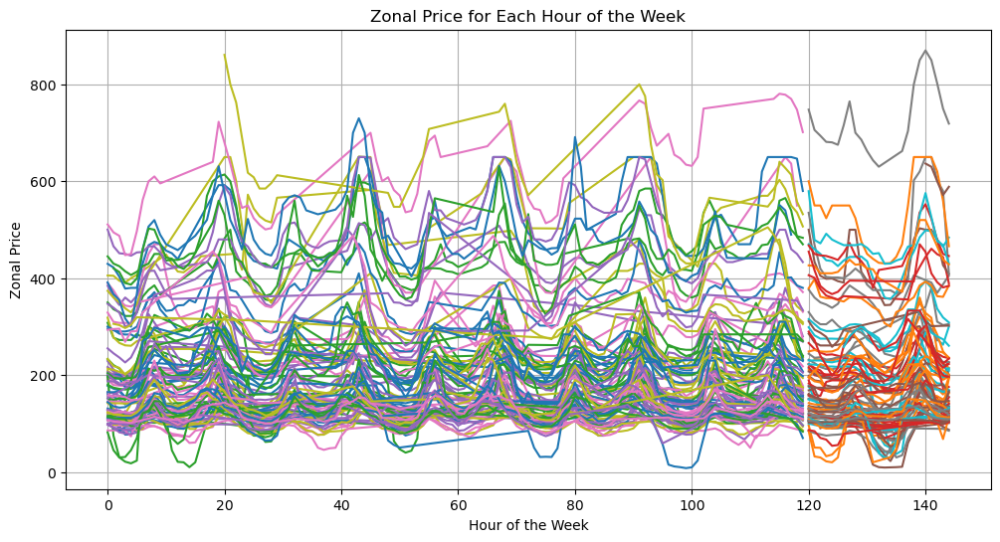

In [43]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming 'Date' column is not in datetime format
# Convert it to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract hour from the 'Date' column
bid_df['Hour'] = bid_df['Date'].dt.hour

# Generate start dates for each week of the year
start_dates = pd.date_range(start='2022-01-01', end='2023-12-31', freq='W-MON')

plt.figure(figsize=(12, 6))

# Iterate over each week
for start_date in start_dates:
    end_date = start_date + pd.DateOffset(days=6)
    
    # Filter data for the current week
    week_data = bid_df[(bid_df['Date'] >= start_date) & (bid_df['Date'] <= end_date)]
    
    # Divide the week data into two parts: Monday to Friday and Saturday to Sunday
    weekend_mask = (week_data['Date'].dt.dayofweek >= 5)  # Saturday and Sunday
    weekday_mask = ~weekend_mask  # Monday to Friday

    weekend_data = week_data[weekend_mask]
    weekday_data = week_data[weekday_mask]

    # Plot the zonal price against hours for each part of the week
    plt.plot(weekday_data['Hour'] + (weekday_data['Date'].dt.dayofweek * 24), weekday_data['ZonalPrice'], label='Weekdays')
    plt.plot(weekend_data['Hour'] + (weekend_data['Date'].dt.dayofweek * 24), weekend_data['ZonalPrice'], label='Weekends')

plt.xlabel('Hour of the Week')
plt.ylabel('Zonal Price')
plt.title('Zonal Price for Each Hour of the Week')

plt.grid(True)
plt.show()

curves for 2022 and 2023

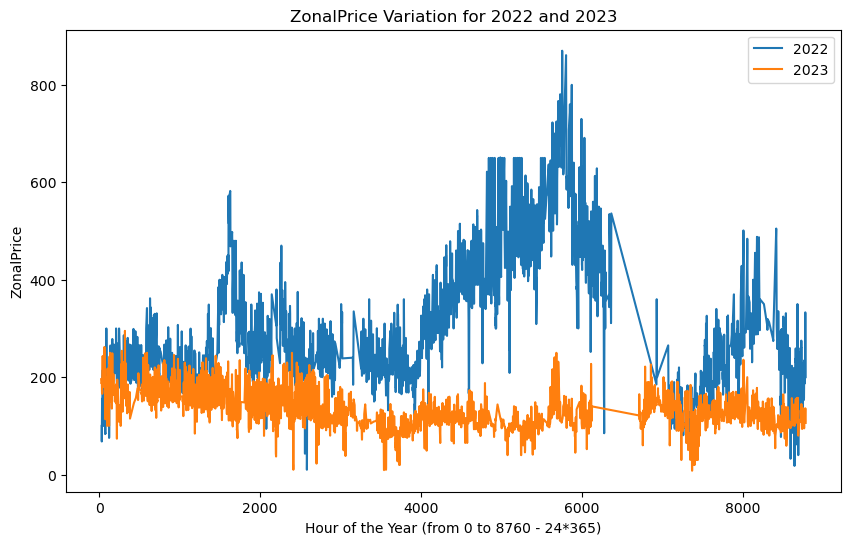

In [ ]:

# Extract year, hour, and ZonalPrice columns
bid_df['Year'] = bid_df['Date'].dt.year
bid_df['Hour_of_year'] = bid_df['Date'].dt.dayofyear * 24 + bid_df['Date'].dt.hour

# Filter data for years 2022 and 2023
data_2022 = bid_df[bid_df['Year'] == 2022]
data_2023 = bid_df[bid_df['Year'] == 2023]

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(data_2022['Hour_of_year'], data_2022['ZonalPrice'], label='2022')
plt.plot(data_2023['Hour_of_year'], data_2023['ZonalPrice'], label='2023')
plt.xlabel('Hour of the Year (from 0 to 8760 - 24*365)')
plt.ylabel('ZonalPrice')
plt.title('ZonalPrice Variation for 2022 and 2023')
plt.legend()

# Set limits for the x-axis
#plt.xlim(0, 24*365)

plt.show()




# FDA 

## smoothing methods for months 

In [2]:
#load bid_df
with open('bid_df.pickle', 'rb') as f:
    bid_df = pickle.load(f)

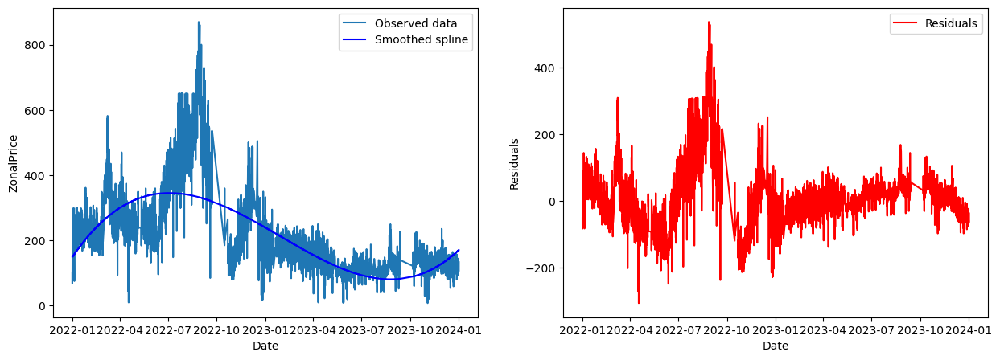

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pygam import LinearGAM, s

# Estrai le colonne che ti interessano
abscissa = pd.to_datetime(bid_df['Date'])
Xobs0 = bid_df['ZonalPrice']

# Calcola il numero di giorni trascorsi dalla data minima
abscissa_days = (abscissa - abscissa.min()).dt.days

# Definisci il numero di nodi per la spline cubica
m = 4

# Crea la matrice dei nodi
breaks = np.linspace(abscissa_days.min(), abscissa_days.max(), m)

# Definisci il modello di smoothing spline
gam = LinearGAM(s(0, n_splines=m)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)

# Valuta il modello
Xss0 = gam.predict(abscissa_days)

# Plot dei risultati
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(abscissa, Xobs0, label='Observed data')
plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.legend()

plt.show()



In [ ]:
## change lambda: 1e-5
gam = LinearGAM(s(0, n_splines=m, lam=1e-5)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0 = gam.predict(abscissa_days)


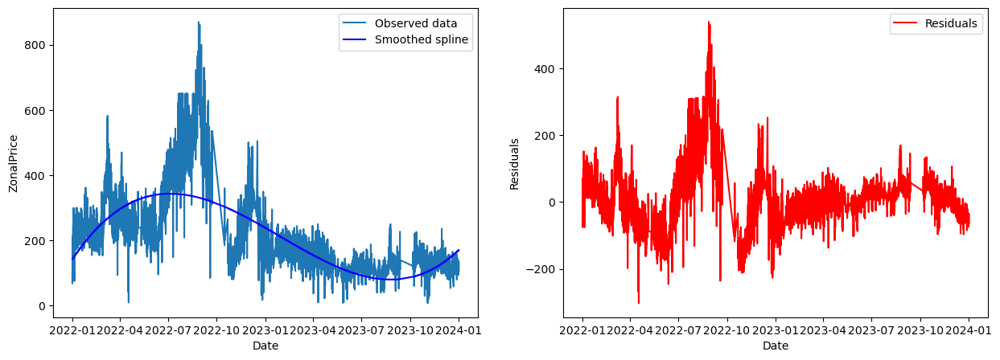

In [ ]:
#plot results with this lambda as before
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(abscissa, Xobs0, label='Observed data')
plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.legend()

plt.show()

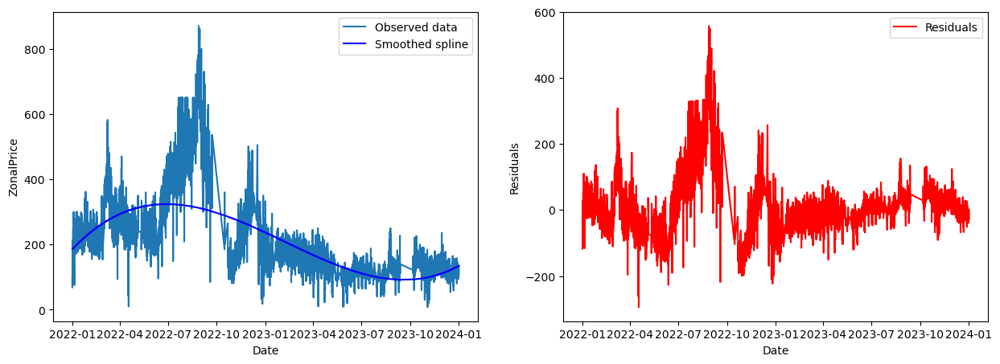

In [ ]:
# change lambda: 1e-12
gam = LinearGAM(s(0, n_splines=m, lam=1e-12)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0 = gam.predict(abscissa_days)

#plot results with this lambda as before
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(abscissa, Xobs0, label='Observed data')
plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.legend()

plt.show()

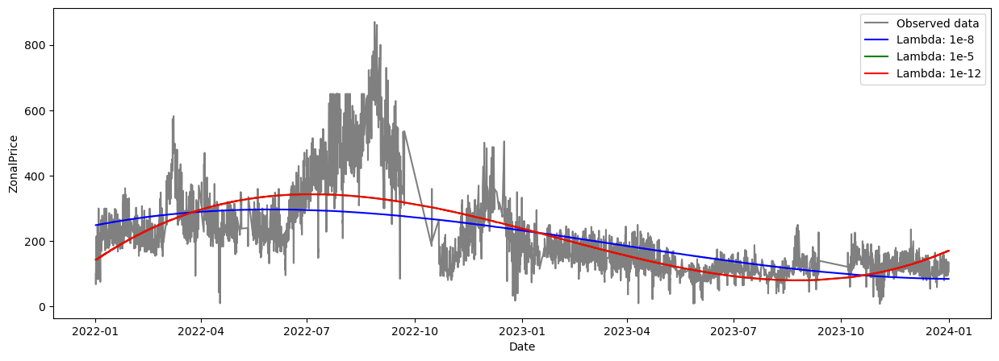

In [ ]:
from pygam import LinearGAM, s

# Estrai le colonne che ti interessano
abscissa = pd.to_datetime(bid_df['Date'])
Xobs0 = bid_df['ZonalPrice']

# Calcola il numero di giorni trascorsi dalla data minima
abscissa_days = (abscissa - abscissa.min()).dt.days

# Definisci il numero di nodi per la spline cubica
m = 4

# Crea la matrice dei nodi
breaks = np.linspace(abscissa_days.min(), abscissa_days.max(), m)

# Definisci il modello di smoothing spline con lambda: 1e-8
gam_lambda_8 = LinearGAM(s(0, n_splines=m)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)

# Valuta il modello con lambda: 1e-8
Xss0_lambda_8 = gam_lambda_8.predict(abscissa_days)

# Cambia lambda: 1e-5
gam_lambda_5 = LinearGAM(s(0, n_splines=m, lam=1e-10)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0_lambda_5 = gam_lambda_5.predict(abscissa_days)

# Cambia lambda: 1e-12
gam_lambda_12 = LinearGAM(s(0, n_splines=m, lam=1e-12)).fit(abscissa_days.values.reshape(-1, 1), Xobs0)
Xss0_lambda_12 = gam_lambda_12.predict(abscissa_days)

# Plot dei risultati
plt.figure(figsize=(15, 5))

plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_8, label='Lambda: 1e-8', color='blue')
plt.plot(abscissa, Xss0_lambda_5, label='Lambda: 1e-5', color='green')
plt.plot(abscissa, Xss0_lambda_12, label='Lambda: 1e-12', color='red')

plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.show()


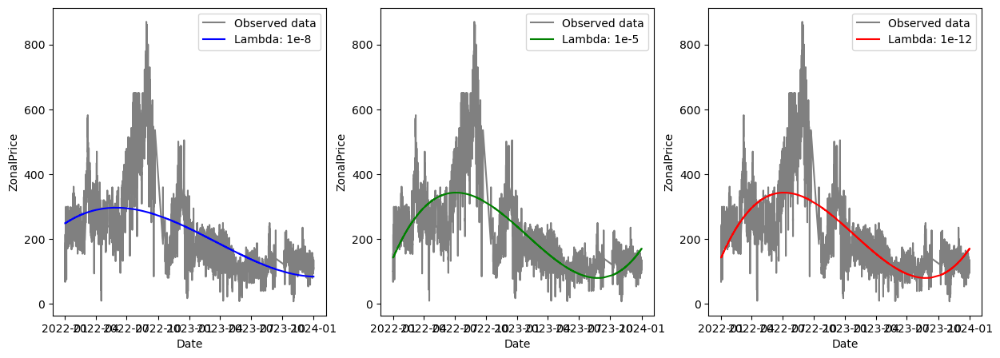

In [ ]:
#sulla stessa riga un plot per ogni lambda
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_8, label='Lambda: 1e-8', color='blue')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 3, 2)
plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_5, label='Lambda: 1e-5', color='green')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.subplot(1, 3, 3)
plt.plot(abscissa, Xobs0, label='Observed data', color='grey')
plt.plot(abscissa, Xss0_lambda_12, label='Lambda: 1e-12', color='red')
plt.xlabel('Date')
plt.ylabel('ZonalPrice')
plt.legend()

plt.show()

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pygam import LinearGAM, s

# Convert the 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])

# Extract the time of day and the day from the 'Date' column
bid_df['Time'] = bid_df['Date'].dt.time
bid_df['Day'] = bid_df['Date'].dt.date

# Extract unique days
unique_days = bid_df['Day'].unique()

# Define the number of splines for smoothing
m = 4

plt.figure(figsize=(15, 5 * len(unique_days)))

# Iterate through each unique day
for i, day in enumerate(unique_days):
    day_data = bid_df[bid_df['Day'] == day]
    abscissa = day_data['Time']
    Xobs0 = day_data['ZonalPrice']

    # Convert time to seconds since midnight for fitting the model
    abscissa_seconds = day_data['Date'].dt.hour * 3600 + day_data['Date'].dt.minute * 60 + day_data['Date'].dt.second

    # Fit the smoothing spline model
    gam = LinearGAM(s(0, n_splines=m)).fit(abscissa_seconds.values.reshape(-1, 1), Xobs0)

    # Evaluate the model
    Xss0 = gam.predict(abscissa_seconds)

    # Plot the observed data and the smoothed spline
    plt.subplot(len(unique_days), 2, 2 * i + 1)
    plt.plot(abscissa, Xobs0, label='Observed data')
    plt.plot(abscissa, Xss0, label='Smoothed spline', color='blue')
    plt.xlabel('Time')
    plt.ylabel('ZonalPrice')
    plt.title(f'Zonal Price on {day}')
    plt.legend()

    # Plot the residuals
    plt.subplot(len(unique_days), 2, 2 * i + 2)
    plt.plot(abscissa, Xobs0 - Xss0, label='Residuals', color='red')
    plt.xlabel('Time')
    plt.ylabel('Residuals')
    plt.title(f'Residuals on {day}')
    plt.legend()

plt.tight_layout()
plt.show()


## smoothing for daily zonal prices

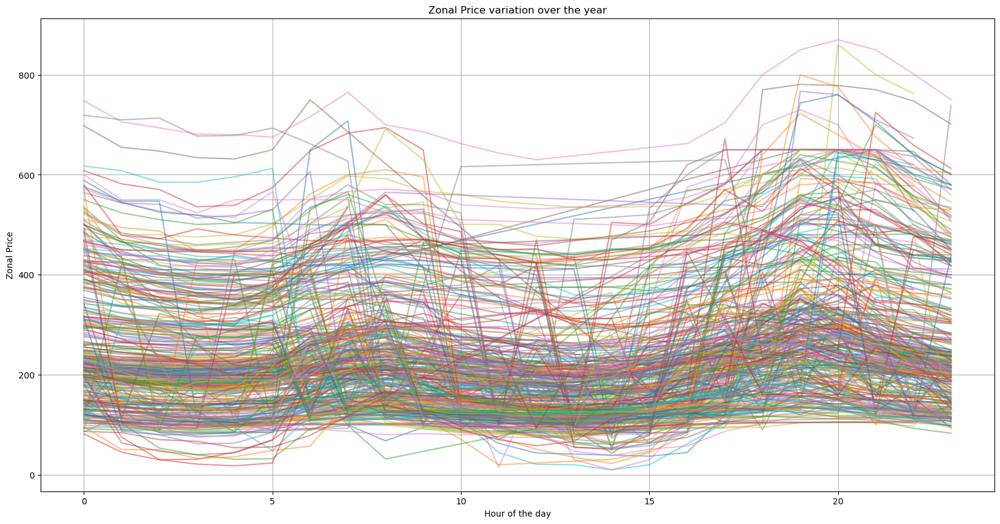

In [61]:
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Remove duplicate 'Hour' values within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

plt.figure(figsize=(20, 10))

for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    plt.plot(daily_data['Hour'], daily_data['ZonalPrice'], label=f'Day {day}', alpha=0.5)

plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Zonal Price variation over the year')
plt.grid(True)
plt.show()


## constrain the function to be positive 

 for all the function

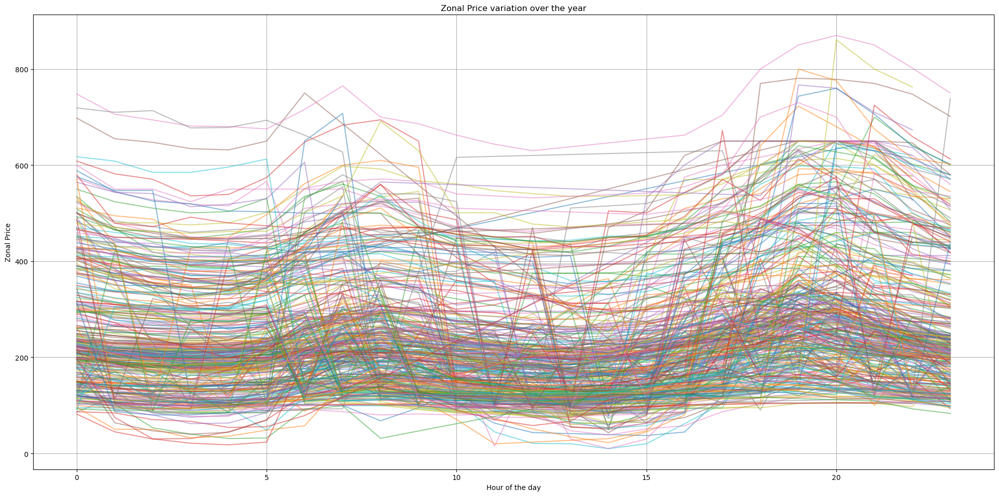

In [60]:
# Import libraries
from scipy.interpolate import UnivariateSpline


# Extract hour and day of year
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove duplicate 'Hour' values within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Plot settings
plt.figure(figsize=(20, 10))

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply logarithmic transformation for positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create spline of transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Plot smoothed data
    plt.plot(daily_data['Hour'], smoothed_price, label=f'Day {day}', alpha=0.5)

# Customize plot
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Zonal Price variation over the year')
plt.grid(True)
plt.tight_layout()  

# Show the plot
plt.show()


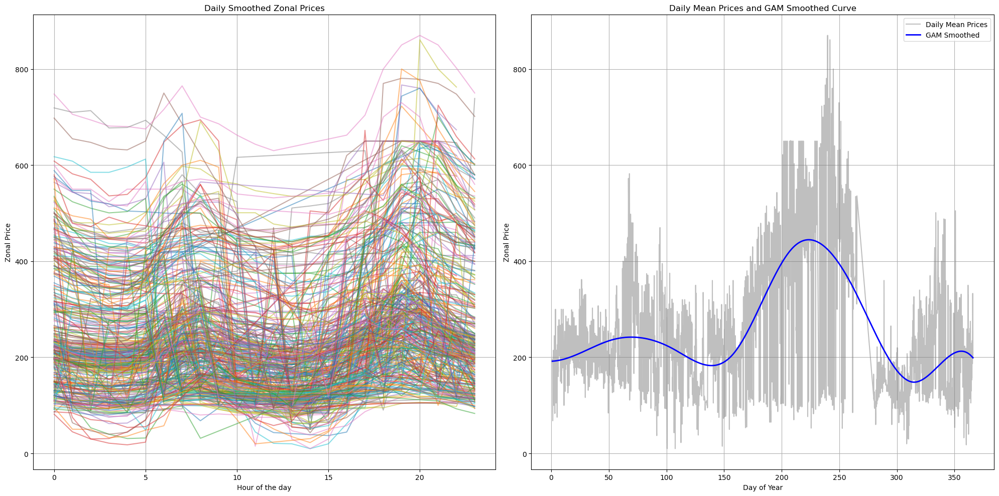

In [66]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Collect smoothed prices for each day
smoothed_prices = []

for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)  # Add 1 to avoid log(0)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    daily_smoothed_data = daily_data.copy()
    daily_smoothed_data['SmoothedPrice'] = smoothed_price
    smoothed_prices.append(daily_smoothed_data)

# Concatenate all daily smoothed data into a single DataFrame
smoothed_bid_df = pd.concat(smoothed_prices)

# Prepare data for GAM smoothing
daily_means = smoothed_bid_df.groupby(['DayOfYear', 'Hour'])['SmoothedPrice'].mean().reset_index()

# Extract columns
abscissa = daily_means['DayOfYear'] + daily_means['Hour'] / 24.0  # Convert to a continuous variable
Xobs0 = daily_means['SmoothedPrice']

# Define the number of knots for the cubic spline
m = 10  # Adjust the number of knots as needed

# Define the smoothing spline model
gam = LinearGAM(s(0, n_splines=m)).fit(abscissa.values.reshape(-1, 1), Xobs0)

# Evaluate the model
Xss0 = gam.predict(abscissa)

# Plot the results
plt.figure(figsize=(20, 10))

# Plot smoothed prices for each day
plt.subplot(1, 2, 1)
for day in bid_df['DayOfYear'].unique():
    daily_data = smoothed_bid_df[smoothed_bid_df['DayOfYear'] == day]
    plt.plot(daily_data['Hour'], daily_data['SmoothedPrice'], label=f'Day {day}', alpha=0.5)
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Daily Smoothed Zonal Prices')
plt.grid(True)
plt.tight_layout()

# Plot daily mean prices and GAM smoothed curve
plt.subplot(1, 2, 2)
plt.plot(daily_means['DayOfYear'] + daily_means['Hour'] / 24.0, Xobs0, label='Daily Mean Prices', color='gray', alpha=0.5)
plt.plot(daily_means['DayOfYear'] + daily_means['Hour'] / 24.0, Xss0, label='GAM Smoothed', color='blue', linewidth=2)
plt.xlabel('Day of Year')
plt.ylabel('Zonal Price')
plt.title('Daily Mean Prices and GAM Smoothed Curve')
plt.legend()
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()


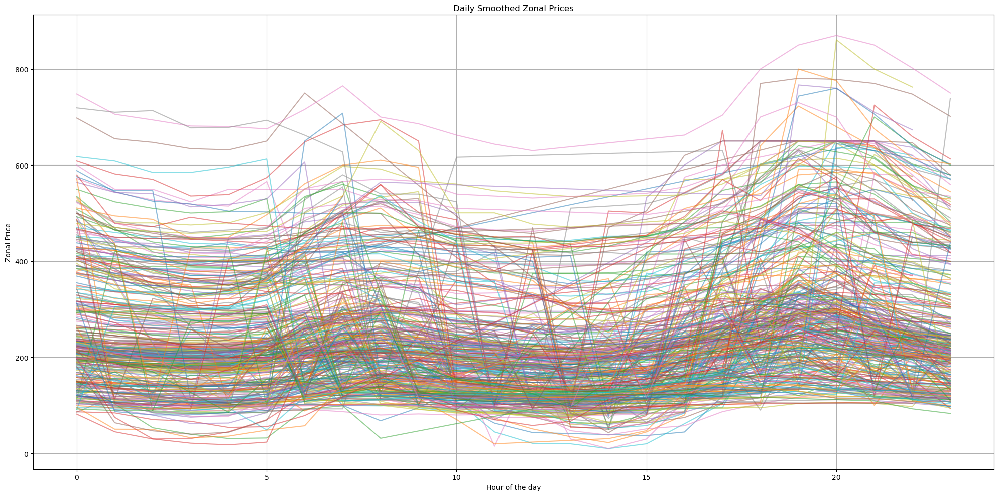

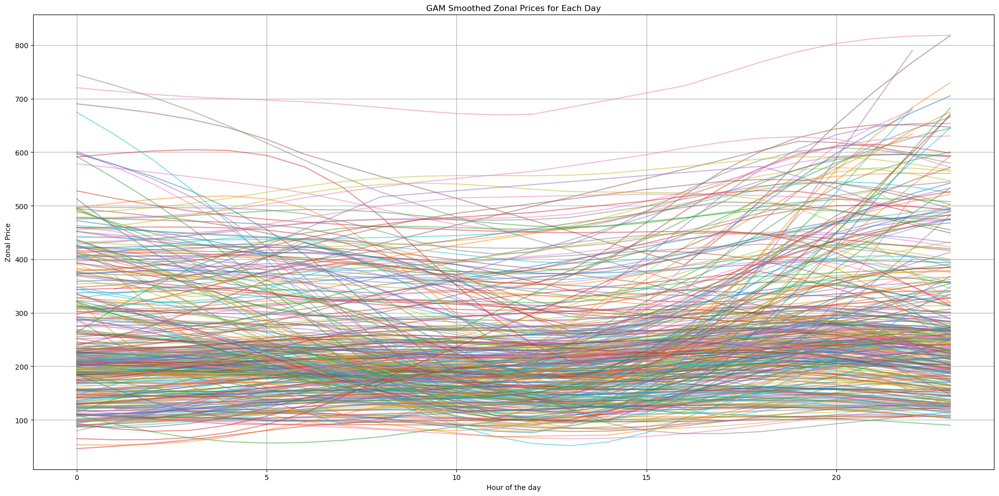

In [69]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

plt.figure(figsize=(20, 10))

# Collect smoothed prices for each day
all_smoothed_prices = []

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Store the smoothed prices
    all_smoothed_prices.append((daily_data['Hour'].values, smoothed_price))
    
    # Plot smoothed data for each day
    plt.plot(daily_data['Hour'], smoothed_price, alpha=0.5, label=f'Day {day}')

# Customize plot
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Daily Smoothed Zonal Prices')
plt.grid(True)
plt.tight_layout()  
plt.show()

# Apply GAM smoothing to each day's smoothed prices
plt.figure(figsize=(20, 10))
for hours, smoothed_prices in all_smoothed_prices:
    hours = hours.reshape(-1, 1)  # Convert to 2D array for GAM
    gam = LinearGAM(s(0, n_splines=10)).fit(hours, smoothed_prices)
    gam_smoothed_prices = gam.predict(hours)
    plt.plot(hours, gam_smoothed_prices, alpha=0.5)

# Customize plot for GAM smoothed prices
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('GAM Smoothed Zonal Prices for Each Day')
plt.grid(True)
plt.tight_layout()  
plt.show()


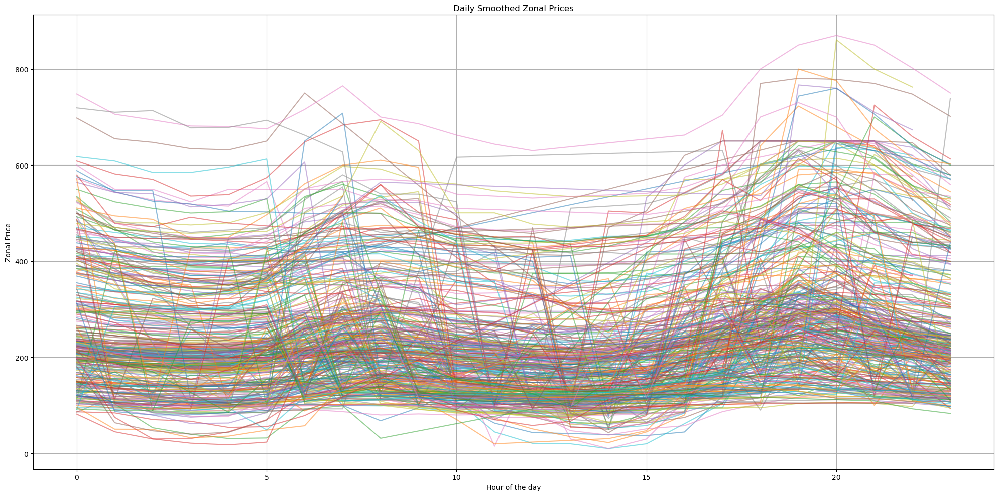

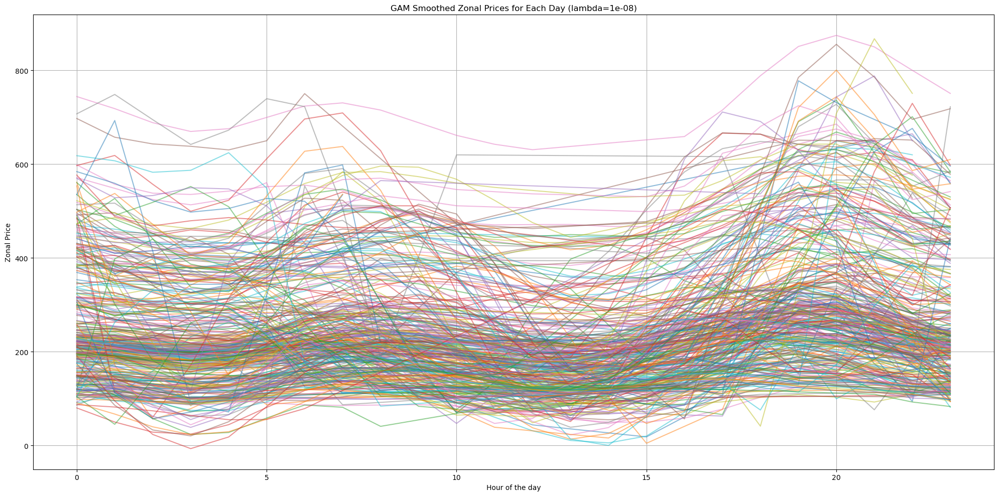

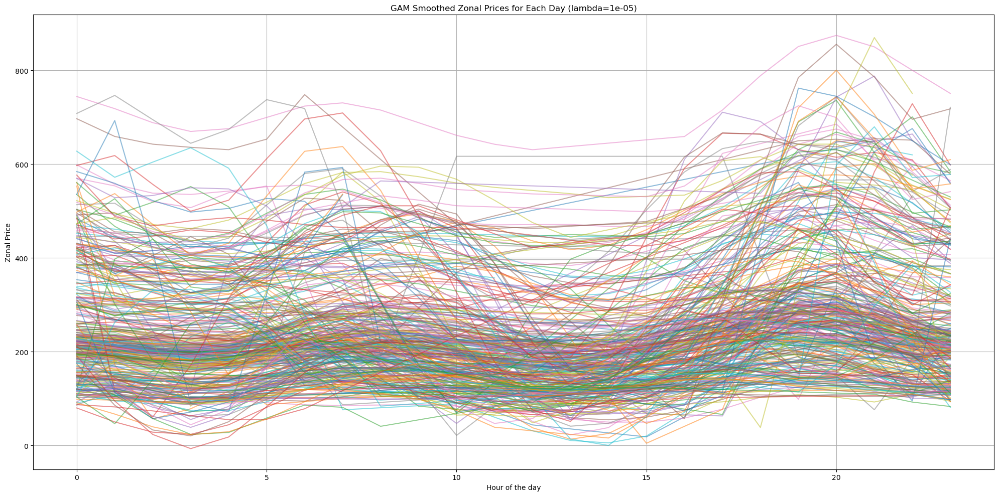

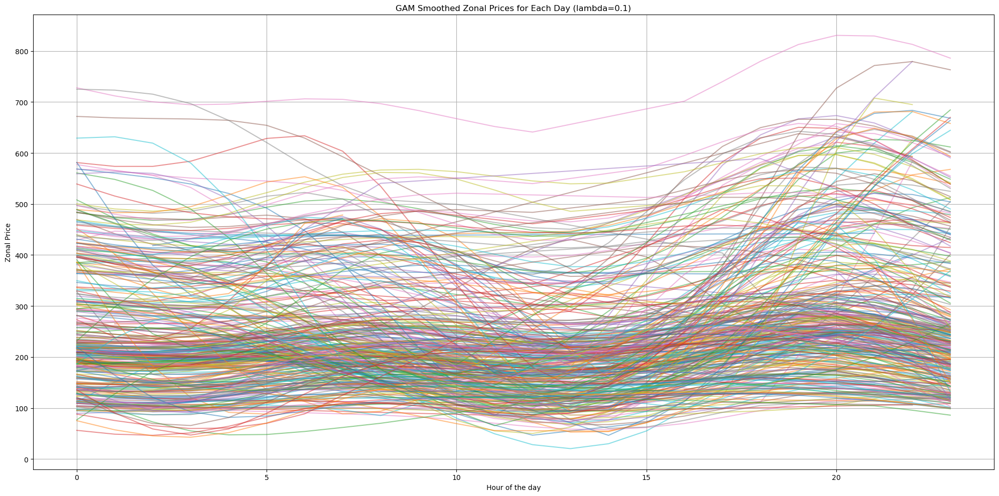

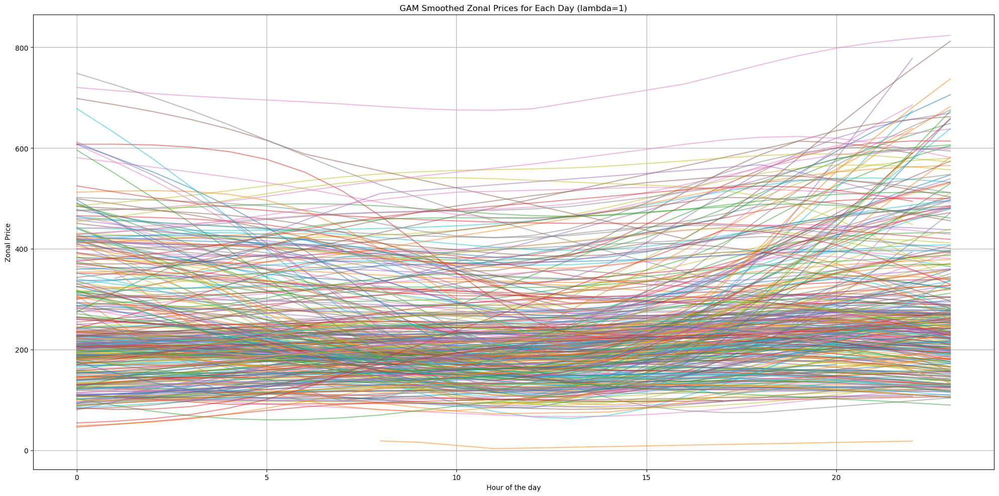

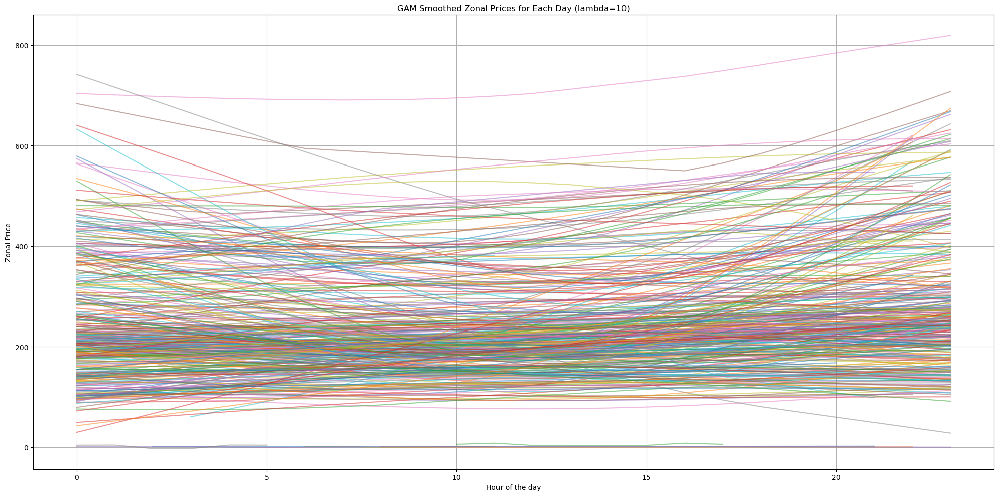

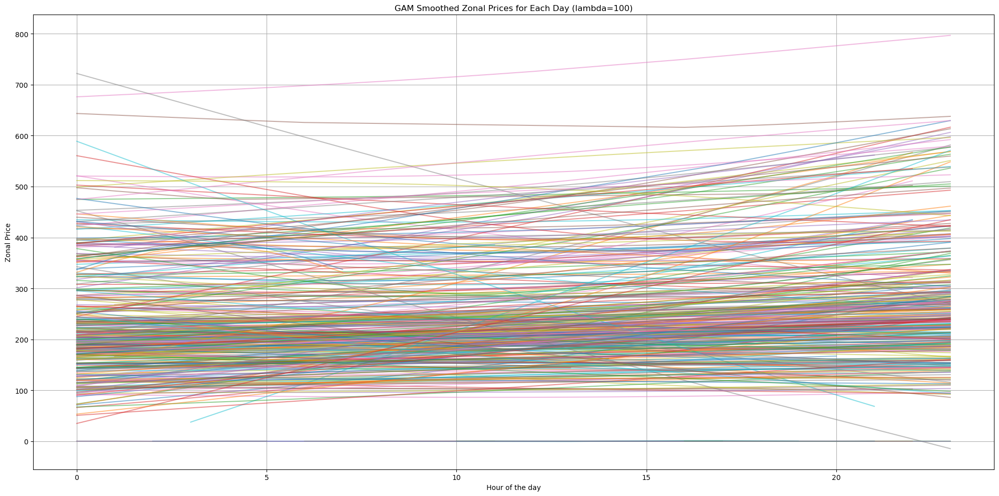

In [71]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

plt.figure(figsize=(20, 10))

# Collect smoothed prices for each day
all_smoothed_prices = []

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Store the smoothed prices
    all_smoothed_prices.append((daily_data['Hour'].values, smoothed_price))
    
    # Plot smoothed data for each day
    plt.plot(daily_data['Hour'], smoothed_price, alpha=0.5, label=f'Day {day}')

# Customize plot
plt.xlabel('Hour of the day')
plt.ylabel('Zonal Price')
plt.title('Daily Smoothed Zonal Prices')
plt.grid(True)
plt.tight_layout()  
plt.show()

# Lambda values to test
lambdas = [1e-8,1e-5,0.1, 1, 10, 100]

# Apply GAM smoothing to each day's smoothed prices for each lambda value
for lam in lambdas:
    plt.figure(figsize=(20, 10))
    for hours, smoothed_prices in all_smoothed_prices:
        hours = hours.reshape(-1, 1)  # Convert to 2D array for GAM
        gam = LinearGAM(s(0, n_splines=10, lam=lam)).fit(hours, smoothed_prices)
        gam_smoothed_prices = gam.predict(hours)
        plt.plot(hours, gam_smoothed_prices, alpha=0.5)

    # Customize plot for GAM smoothed prices
    plt.xlabel('Hour of the day')
    plt.ylabel('Zonal Price')
    plt.title(f'GAM Smoothed Zonal Prices for Each Day (lambda={lam})')
    plt.grid(True)
    plt.tight_layout()  
    plt.show()


Derivates Check


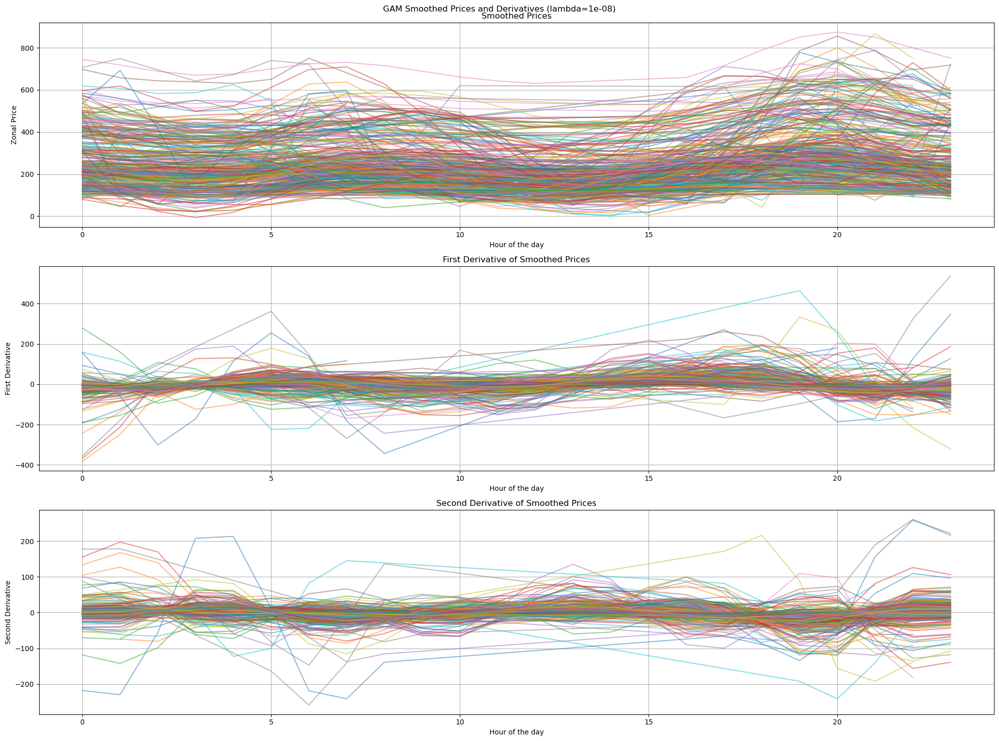

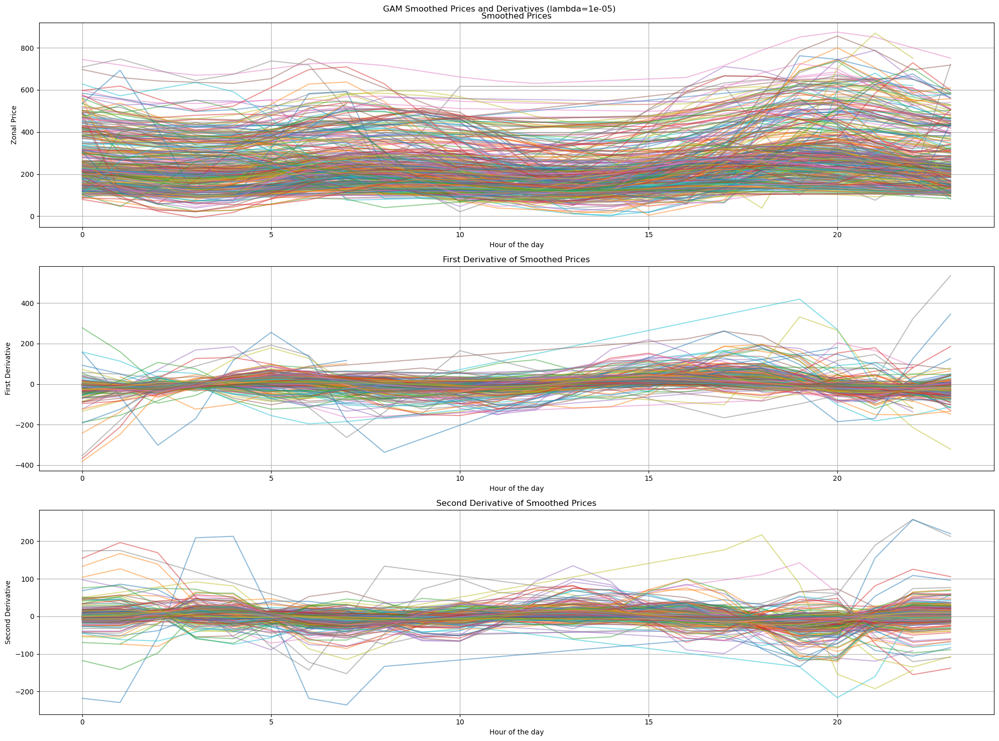

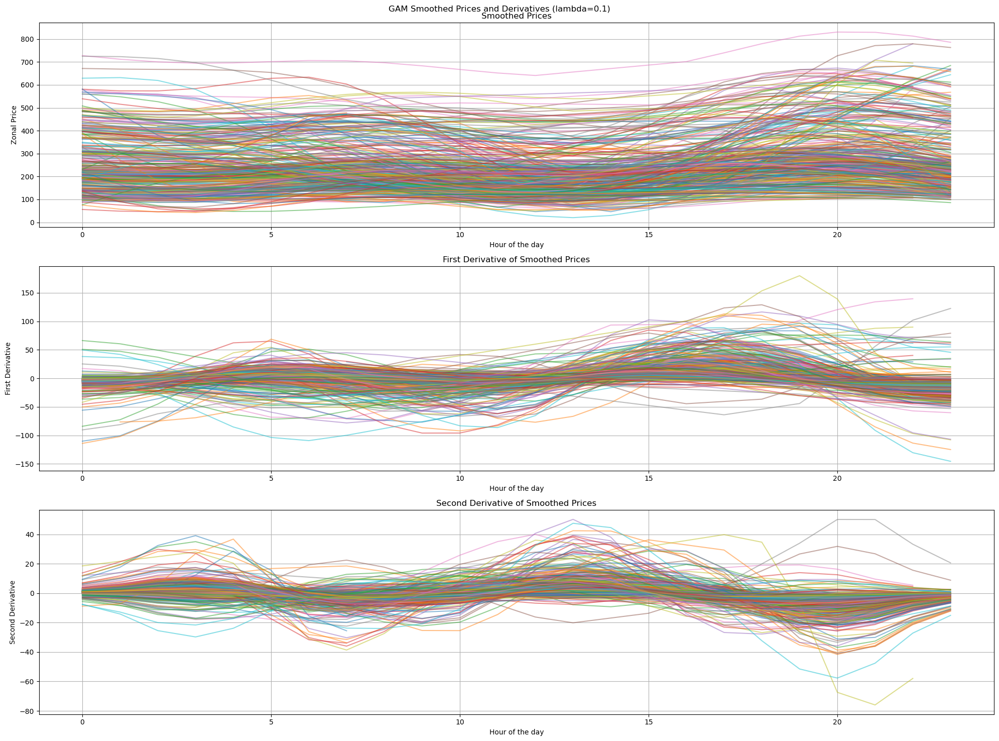

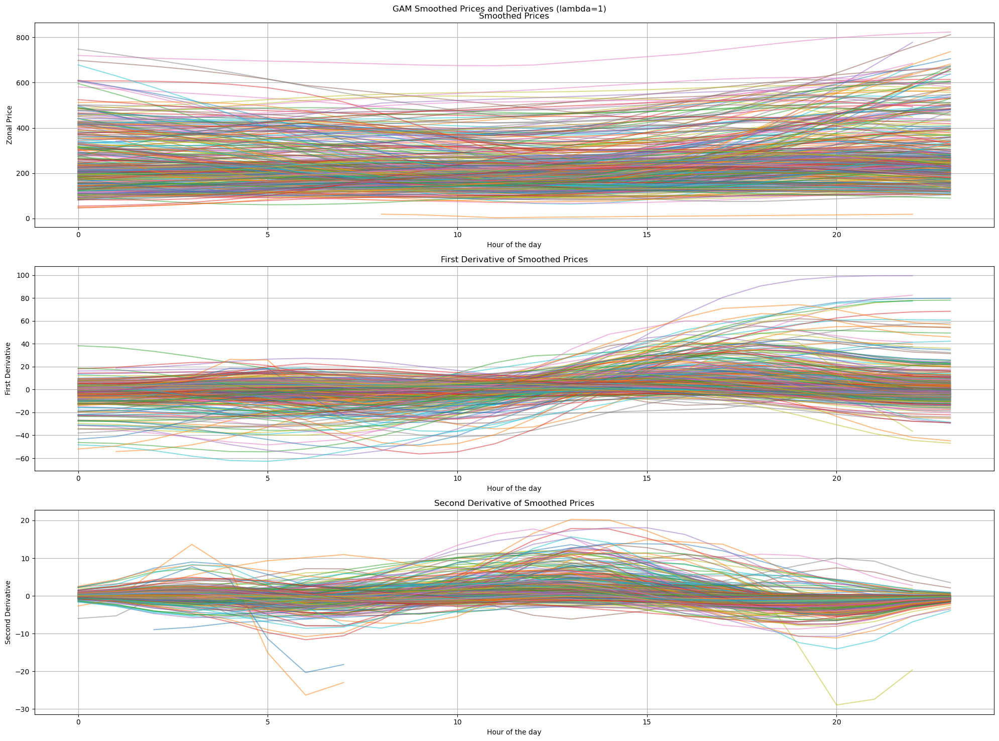

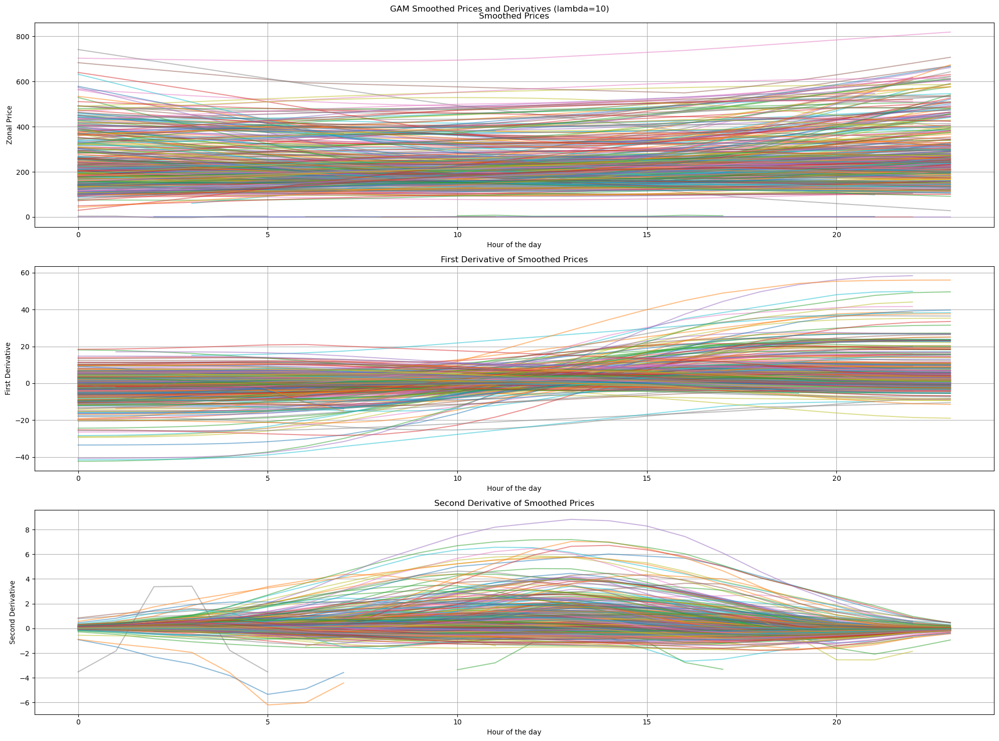

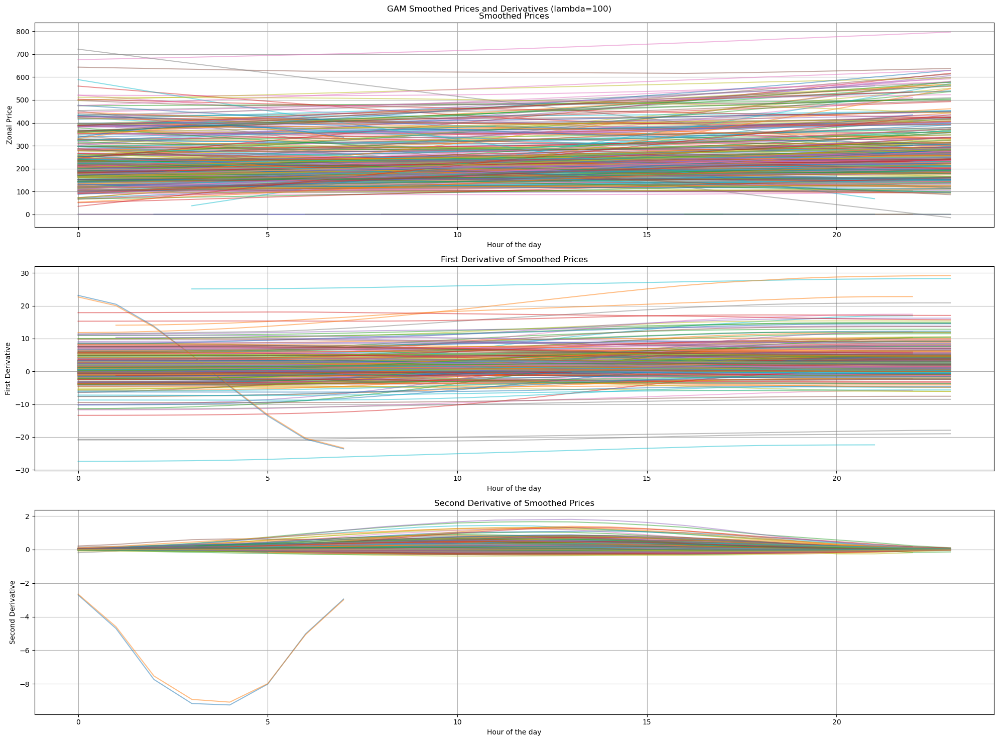

GCV values for each lambda:
Lambda: 1e-08, GCV: 5420.29
Lambda: 1e-05, GCV: 5207.30
Lambda: 0.1, GCV: 3601.57
Lambda: 1, GCV: 5228.12
Lambda: 10, GCV: 6677.58
Lambda: 100, GCV: 8008.84


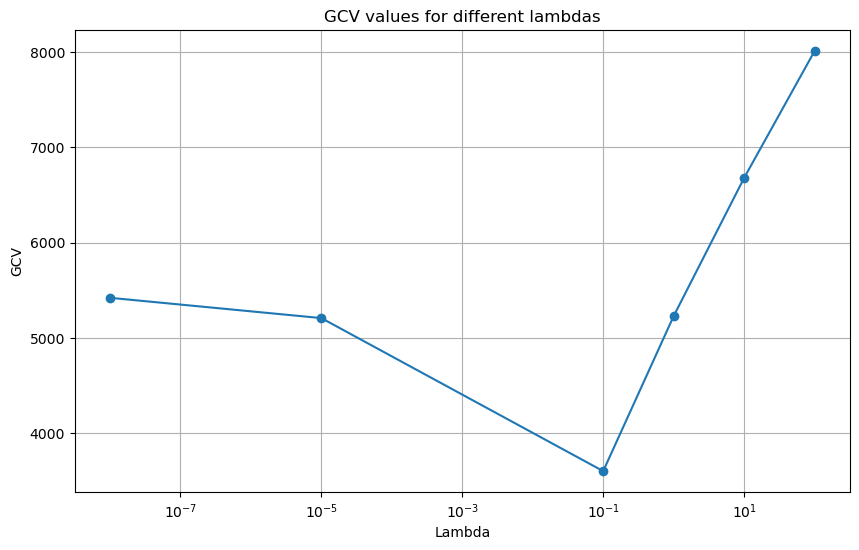

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s
from sklearn.metrics import mean_squared_error

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Lambda values to test
lambdas = [1e-8, 1e-5, 0.1, 1, 10, 100]

# Dictionary to store GCV values for each lambda
gcv_values_by_lambda = {}

for lam in lambdas:
    fig, axes = plt.subplots(3, 1, figsize=(20, 15))
    fig.suptitle(f'GAM Smoothed Prices and Derivatives (lambda={lam})')
    
    # List to store GCV values for each day
    daily_gcv_values = []
    
    # Iterate over each unique day of the year
    for day in bid_df['DayOfYear'].unique():
        daily_data = bid_df[bid_df['DayOfYear'] == day]
        
        # Apply log transformation to ensure positivity
        log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
        
        # Create a spline of the transformed data
        spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
        
        # Apply the inverse exponential to return to original values
        smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
        
        # Apply GAM smoothing
        hours = daily_data['Hour'].values.reshape(-1, 1)
        gam = LinearGAM(s(0, n_splines=10, lam=lam)).fit(hours, smoothed_price)
        gam_smoothed_prices = gam.predict(hours)
        
        # Compute first and second derivatives using central finite differences
        first_derivative = np.gradient(gam_smoothed_prices, daily_data['Hour'])
        second_derivative = np.gradient(first_derivative, daily_data['Hour'])
        
        # Calculate GCV for the current day
        n = len(smoothed_price)
        residuals = smoothed_price - gam_smoothed_prices
        edf = gam.statistics_['edof']
        gcv = (n * np.sum(residuals ** 2)) / ((n - edf) ** 2)
        daily_gcv_values.append(gcv)
        
        # Plot original smoothed data
        axes[0].plot(daily_data['Hour'], gam_smoothed_prices, label=f'Day {day}', alpha=0.5)
        
        # Plot first derivative
        axes[1].plot(daily_data['Hour'], first_derivative, label=f'Day {day}', alpha=0.5)
        
        # Plot second derivative
        axes[2].plot(daily_data['Hour'], second_derivative, label=f'Day {day}', alpha=0.5)
    
    # Store mean GCV for the current lambda
    mean_gcv = np.mean(daily_gcv_values)
    gcv_values_by_lambda[lam] = mean_gcv
    
    # Customize plots
    axes[0].set_xlabel('Hour of the day')
    axes[0].set_ylabel('Zonal Price')
    axes[0].set_title('Smoothed Prices')
    axes[0].grid(True)

    axes[1].set_xlabel('Hour of the day')
    axes[1].set_ylabel('First Derivative')
    axes[1].set_title('First Derivative of Smoothed Prices')
    axes[1].grid(True)

    axes[2].set_xlabel('Hour of the day')
    axes[2].set_ylabel('Second Derivative')
    axes[2].set_title('Second Derivative of Smoothed Prices')
    axes[2].grid(True)

    plt.tight_layout()
    plt.show()

# Print the GCV values for each lambda
print("GCV values for each lambda:")
for lam, gcv in gcv_values_by_lambda.items():
    print(f"Lambda: {lam}, GCV: {gcv:.2f}")

# Plot the GCV values for each lambda
plt.figure(figsize=(10, 6))
plt.plot(list(gcv_values_by_lambda.keys()), list(gcv_values_by_lambda.values()), marker='o')
plt.xlabel('Lambda')
plt.ylabel('GCV')
plt.title('GCV values for different lambdas')
plt.xscale('log')  # Use logarithmic scale for lambda
plt.grid(True)
plt.show()


### GCV Plot Interpretation
1. **X-Axis (Lambda)**: This represents the values of the smoothing parameter \(\lambda\) on a logarithmic scale.
2. **Y-Axis (GCV)**: This represents the Generalized Cross-Validation (GCV) values calculated for each \(\lambda\).

### Analysis
- **Minimum GCV**: The \(\lambda\) value that minimizes the GCV is the most desirable because it indicates the best trade-off between model complexity and fitting the data. From the plot, we can see that the GCV is minimized at \(\lambda = 0.1\). This suggests that \(\lambda = 0.1\) is the optimal smoothing parameter for your data among the tested values.
- **GCV Behavior**:
  - For very small \(\lambda\) values (e.g., \(1 \times 10^{-8}\) and \(1 \times 10^{-5}\)), the GCV is relatively high, indicating that the model might be too complex and overfitting the data.
  - For very large \(\lambda\) values (e.g., 10 and 100), the GCV increases significantly, suggesting that the model is too simple and not adequately capturing the data's variability (underfitting).
  - An intermediate \(\lambda\) value, such as 0.1, optimizes the trade-off between complexity and fit, resulting in a lower GCV value.

### Conclusions
- **Lambda Selection**: Based on the results, you should consider using \(\lambda = 0.1\) for your GAM model, as this value minimizes the GCV and thus should provide the best trade-off between bias and variance.
- **Validation**: It might be useful to perform additional cross-validation to confirm that \(\lambda = 0.1\) works well across different subsets of the data.


## lambda = 0.1 

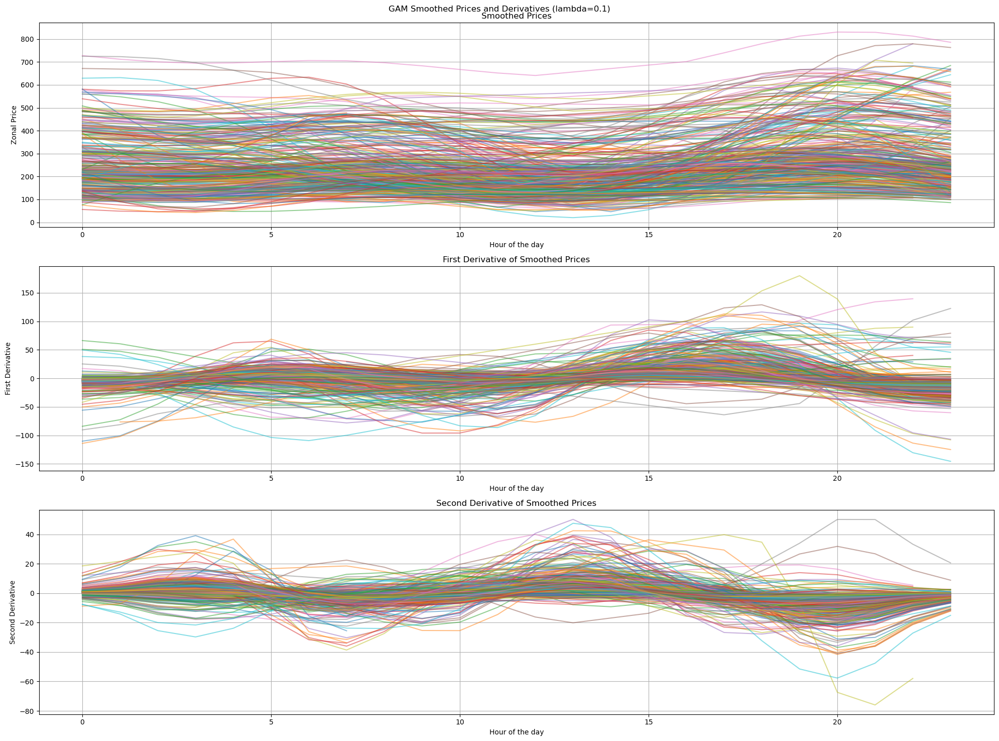

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s

# Assumi che bid_df sia già definito e abbia le colonne 'Date' e 'ZonalPrice'
# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Lambda value to test
lambda_to_test = 0.1

fig, axes = plt.subplots(3, 1, figsize=(20, 15))
fig.suptitle(f'GAM Smoothed Prices and Derivatives (lambda={lambda_to_test})')

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Apply GAM smoothing
    hours = daily_data['Hour'].values.reshape(-1, 1)
    gam = LinearGAM(s(0, n_splines=10, lam=lambda_to_test)).fit(hours, smoothed_price)
    gam_smoothed_prices = gam.predict(hours)
    
    # Compute first and second derivatives using central finite differences
    first_derivative = np.gradient(gam_smoothed_prices, daily_data['Hour'])
    second_derivative = np.gradient(first_derivative, daily_data['Hour'])
    
    # Plot original smoothed data
    axes[0].plot(daily_data['Hour'], gam_smoothed_prices, label=f'Day {day}', alpha=0.5)
    
    # Plot first derivative
    axes[1].plot(daily_data['Hour'], first_derivative, label=f'Day {day}', alpha=0.5)
    
    # Plot second derivative
    axes[2].plot(daily_data['Hour'], second_derivative, label=f'Day {day}', alpha=0.5)

# Customize plots
axes[0].set_xlabel('Hour of the day')
axes[0].set_ylabel('Zonal Price')
axes[0].set_title('Smoothed Prices')
axes[0].grid(True)

axes[1].set_xlabel('Hour of the day')
axes[1].set_ylabel('First Derivative')
axes[1].set_title('First Derivative of Smoothed Prices')
axes[1].grid(True)

axes[2].set_xlabel('Hour of the day')
axes[2].set_ylabel('Second Derivative')
axes[2].set_title('Second Derivative of Smoothed Prices')
axes[2].grid(True)

plt.tight_layout()
plt.show()


# FPCA

2 principal component 

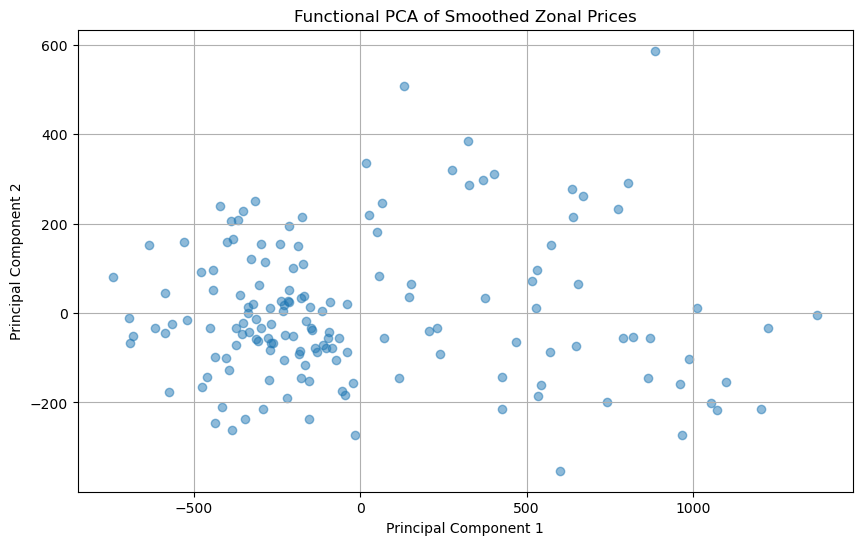

Explained variance ratio: [0.8403811  0.09233606]


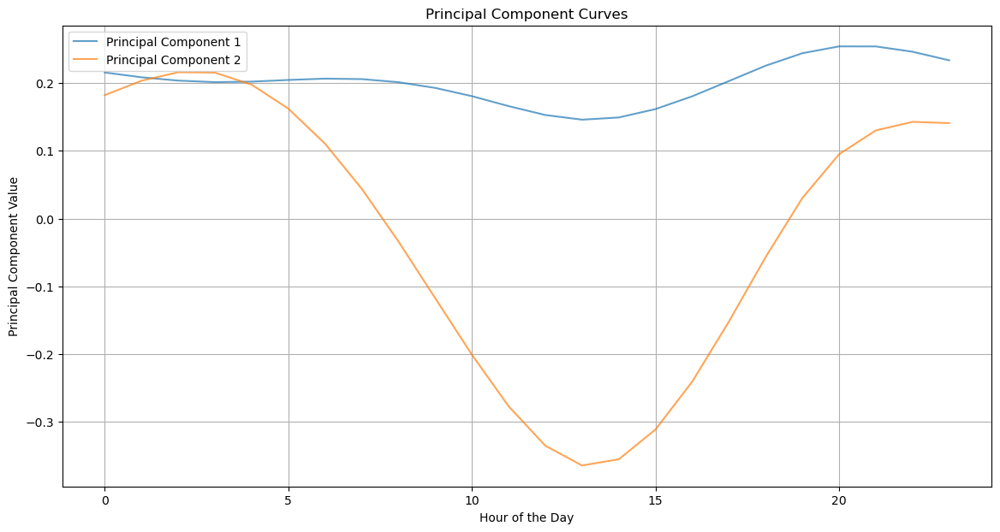

In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s
from sklearn.decomposition import PCA

# Assumi che bid_df sia già definito e abbia le colonne 'Date' e 'ZonalPrice'
# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Lambda value to test
lambda_to_test = 0.1

# List to store smoothed prices for each day
smoothed_prices_by_day = []

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Apply GAM smoothing
    hours = daily_data['Hour'].values.reshape(-1, 1)
    gam = LinearGAM(s(0, n_splines=10, lam=lambda_to_test)).fit(hours, smoothed_price)
    gam_smoothed_prices = gam.predict(hours)
    
    # Store the smoothed prices for the day
    smoothed_prices_by_day.append(gam_smoothed_prices)

# Convert the list of smoothed prices into a DataFrame
smoothed_prices_df = pd.DataFrame(smoothed_prices_by_day)

# Check for NaN values and handle them
smoothed_prices_df = smoothed_prices_df.dropna()  # Drop rows with NaN values
# Alternatively, you could fill NaN values, e.g.:
# smoothed_prices_df = smoothed_prices_df.fillna(smoothed_prices_df.mean())

# Apply PCA to the smoothed prices
pca = PCA(n_components=2)  # Adjust the number of components as needed
principal_components = pca.fit_transform(smoothed_prices_df)

# Plot the first two principal components
plt.figure(figsize=(10, 6))
plt.scatter(principal_components[:, 0], principal_components[:, 1], alpha=0.5)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Functional PCA of Smoothed Zonal Prices')
plt.grid(True)
plt.show()

# Print explained variance ratio
print('Explained variance ratio:', pca.explained_variance_ratio_)

# Extract the principal component curves
pc1_curve = pca.components_[0]
pc2_curve = pca.components_[1]

# Plot the principal component curves
plt.figure(figsize=(14, 7))
plt.plot(smoothed_prices_df.columns, pc1_curve, label='Principal Component 1', alpha=0.7)
plt.plot(smoothed_prices_df.columns, pc2_curve, label='Principal Component 2', alpha=0.7)
plt.xlabel('Hour of the Day')
plt.ylabel('Principal Component Value')
plt.title('Principal Component Curves')
plt.legend()
plt.grid(True)
plt.show()


3 components 


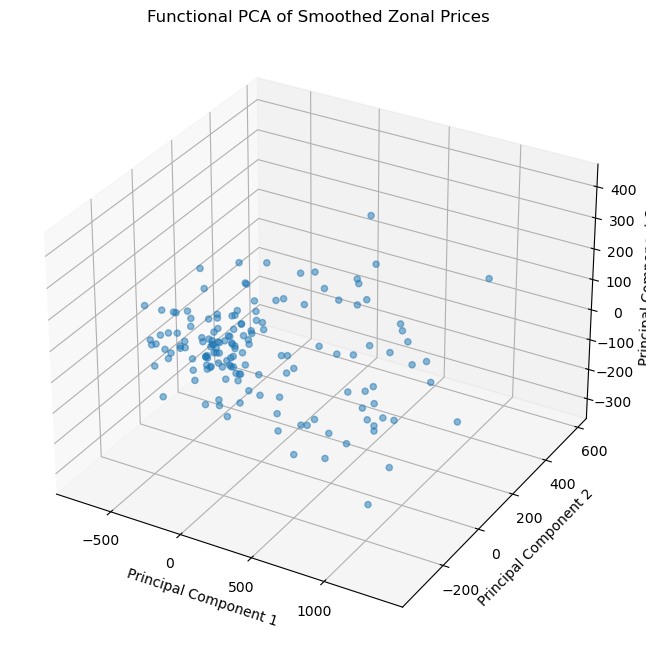

Explained variance ratio: [0.8403811  0.09233606 0.03834534]


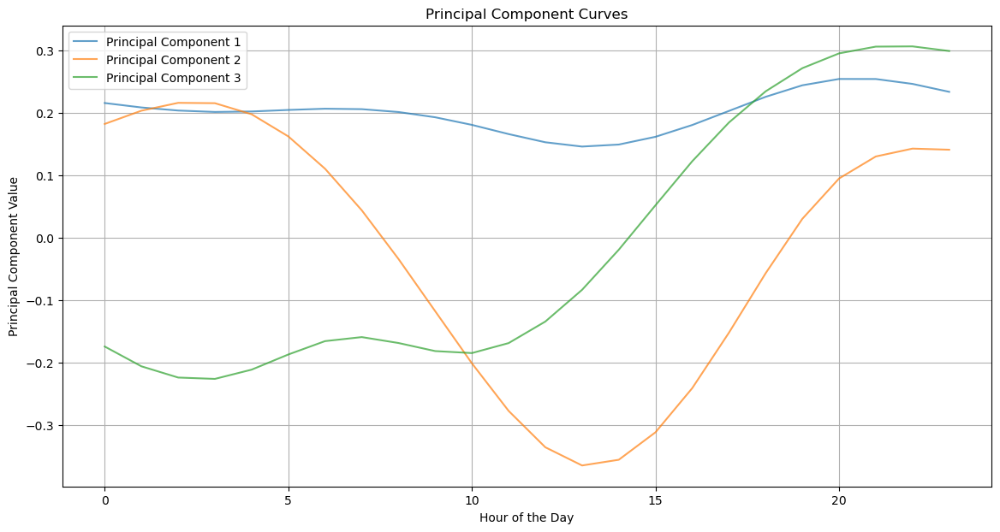

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s
from sklearn.decomposition import PCA

# Assumi che bid_df sia già definito e abbia le colonne 'Date' e 'ZonalPrice'
# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Lambda value to test
lambda_to_test = 0.1

# List to store smoothed prices for each day
smoothed_prices_by_day = []

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Apply GAM smoothing
    hours = daily_data['Hour'].values.reshape(-1, 1)
    gam = LinearGAM(s(0, n_splines=10, lam=lambda_to_test)).fit(hours, smoothed_price)
    gam_smoothed_prices = gam.predict(hours)
    
    # Store the smoothed prices for the day
    smoothed_prices_by_day.append(gam_smoothed_prices)

# Convert the list of smoothed prices into a DataFrame
smoothed_prices_df = pd.DataFrame(smoothed_prices_by_day)

# Check for NaN values and handle them
smoothed_prices_df = smoothed_prices_df.dropna()  # Drop rows with NaN values
# Alternatively, you could fill NaN values, e.g.:
# smoothed_prices_df = smoothed_prices_df.fillna(smoothed_prices_df.mean())

# Apply PCA to the smoothed prices
pca = PCA(n_components=3)  # Adjust the number of components to 3
principal_components = pca.fit_transform(smoothed_prices_df)

# Plot the first three principal components in a 3D scatter plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(principal_components[:, 0], principal_components[:, 1], principal_components[:, 2], alpha=0.5)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.title('Functional PCA of Smoothed Zonal Prices')
plt.show()

# Print explained variance ratio
print('Explained variance ratio:', pca.explained_variance_ratio_)

# Extract the principal component curves
pc1_curve = pca.components_[0]
pc2_curve = pca.components_[1]
pc3_curve = pca.components_[2]

# Plot the principal component curves
plt.figure(figsize=(14, 7))
plt.plot(smoothed_prices_df.columns, pc1_curve, label='Principal Component 1', alpha=0.7)
plt.plot(smoothed_prices_df.columns, pc2_curve, label='Principal Component 2', alpha=0.7)
plt.plot(smoothed_prices_df.columns, pc3_curve, label='Principal Component 3', alpha=0.7)
plt.xlabel('Hour of the Day')
plt.ylabel('Principal Component Value')
plt.title('Principal Component Curves')
plt.legend()
plt.grid(True)
plt.show()


# K Means 

/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


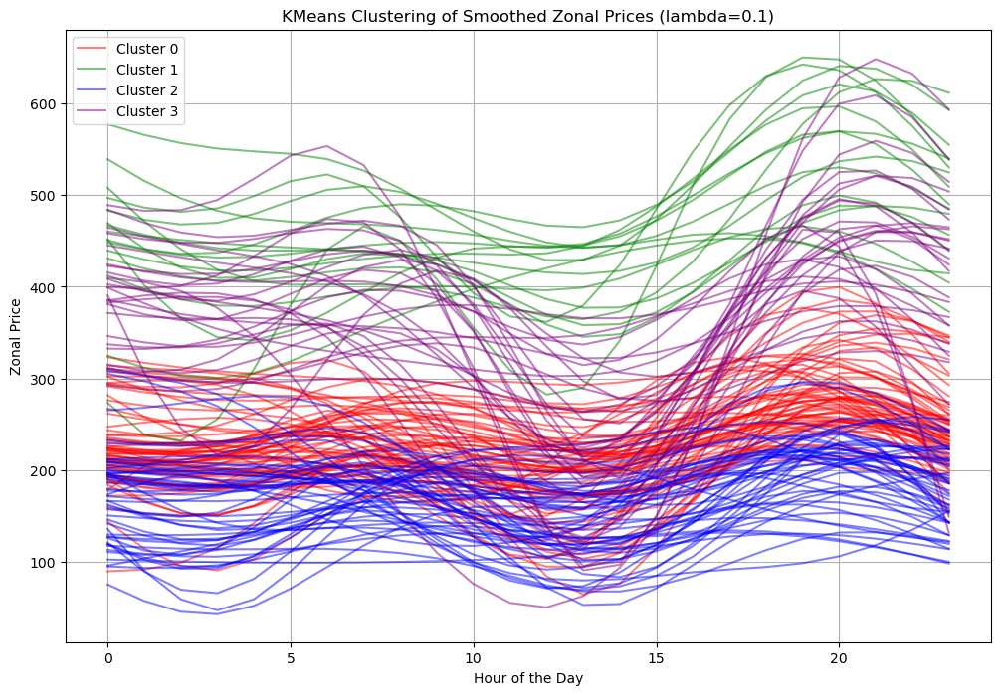

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from pygam import LinearGAM, s
from sklearn.cluster import KMeans

# Assumi che bid_df sia già definito e abbia le colonne 'Date' e 'ZonalPrice'
# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Lambda value to test
lambda_to_test = 0.1

# List to store smoothed prices for each day
smoothed_prices_by_day = []

# Iterate over each unique day of the year
for day in bid_df['DayOfYear'].unique():
    daily_data = bid_df[bid_df['DayOfYear'] == day]
    
    # Apply log transformation to ensure positivity
    log_zonal_price = np.log(daily_data['ZonalPrice'] + 1)
    
    # Create a spline of the transformed data
    spline = UnivariateSpline(daily_data['Hour'], log_zonal_price, s=0)
    
    # Apply the inverse exponential to return to original values
    smoothed_price = np.exp(spline(daily_data['Hour'])) - 1
    
    # Apply GAM smoothing
    hours = daily_data['Hour'].values.reshape(-1, 1)
    gam = LinearGAM(s(0, n_splines=10, lam=lambda_to_test)).fit(hours, smoothed_price)
    gam_smoothed_prices = gam.predict(hours)
    
    # Store the smoothed prices for the day
    smoothed_prices_by_day.append(gam_smoothed_prices)

# Convert the list of smoothed prices into a DataFrame
smoothed_prices_df = pd.DataFrame(smoothed_prices_by_day, columns=range(24))

# Check for NaN values and handle them
smoothed_prices_df = smoothed_prices_df.dropna()  # Drop rows with NaN values
# Alternatively, you could fill NaN values, e.g.:
# smoothed_prices_df = smoothed_prices_df.fillna(smoothed_prices_df.mean())

# Apply KMeans to the smoothed prices
n_clusters = 4 # Adjust the number of clusters as needed
kmeans = KMeans(n_clusters=n_clusters, random_state=0)
clusters = kmeans.fit_predict(smoothed_prices_df)

# Plot the clustered smoothed prices with distinct colors
plt.figure(figsize=(12, 8))
colors = ['red', 'green', 'blue', 'purple', 'orange', 'cyan']  # Extend this list if needed
for cluster in range(n_clusters):
    cluster_data = smoothed_prices_df[clusters == cluster]
    for i in range(cluster_data.shape[0]):
        plt.plot(cluster_data.columns, cluster_data.iloc[i, :], color=colors[cluster], alpha=0.5, label=f'Cluster {cluster}' if i == 0 else "")
plt.xlabel('Hour of the Day')
plt.ylabel('Zonal Price')
plt.title(f'KMeans Clustering of Smoothed Zonal Prices (lambda={lambda_to_test})')
plt.legend()
plt.grid(True)
plt.show()




/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/sklearn/clus

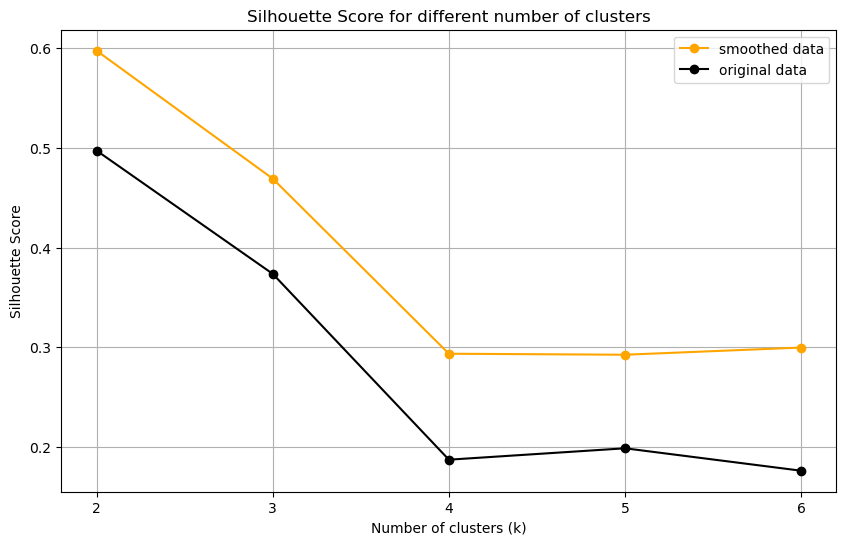

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Convert 'Date' column to datetime
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Hour'] = bid_df['Date'].dt.hour
bid_df['DayOfYear'] = bid_df['Date'].dt.dayofyear

# Sort the DataFrame by 'Hour' and 'DayOfYear'
bid_df = bid_df.sort_values(by=['DayOfYear', 'Hour'])

# Remove any duplicate 'Hour' entries within each day
bid_df = bid_df.drop_duplicates(subset=['DayOfYear', 'Hour'])

# Create the original_data DataFrame (pivoted to have hours as columns and days as rows)
original_data = bid_df.pivot(index='DayOfYear', columns='Hour', values='ZonalPrice')

# Handle NaN values
original_data = original_data.fillna(original_data.mean())

# Assume smoothed_prices_df is the DataFrame of smoothed prices you have already calculated

# Lists to store silhouette scores for each number of clusters
silhouette_scores_with_alignment = []
silhouette_scores_without_alignment = []

# Range of cluster numbers to test
range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Apply KMeans with n_clusters on smoothed data
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    clusters = kmeans.fit_predict(smoothed_prices_df)
    
    # Calculate the silhouette score
    silhouette_avg = silhouette_score(smoothed_prices_df, clusters)
    
    # Add the score to the list
    silhouette_scores_with_alignment.append(silhouette_avg)
    
    # Apply KMeans with n_clusters on original data
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    clusters = kmeans.fit_predict(original_data)
    silhouette_avg = silhouette_score(original_data, clusters)
    silhouette_scores_without_alignment.append(silhouette_avg)

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(range_n_clusters, silhouette_scores_with_alignment, label='smoothed data', marker='o', color='orange')
plt.plot(range_n_clusters, silhouette_scores_without_alignment, label='original data', marker='o', color='black')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score for different number of clusters')
plt.legend()
plt.grid(True)
plt.xticks(range(range_n_clusters[0], range_n_clusters[-1] + 1))  # Set x-axis to show only integer values
plt.show()



### Silhouette Score Plot Interpretation
1. **X-Axis (Number of clusters \(k\))**: This represents the number of clusters used in the KMeans clustering.
2. **Y-Axis (Silhouette Score)**: This represents the silhouette score, which is a measure of how similar an object is to its own cluster compared to other clusters. Higher values indicate better-defined clusters.

### Analysis
- **Smoothed Data vs. Original Data**: The plot shows two lines: one for the smoothed data (orange) and one for the original data (black).
  - **Smoothed Data**: The silhouette score for the smoothed data starts high at \(k=2\) and decreases as \(k\) increases, stabilizing around \(k=4\).
  - **Original Data**: The silhouette score for the original data is consistently lower than the smoothed data, indicating that the clusters are less well-defined without smoothing. The score also decreases as \(k\) increases but shows slight improvements at higher \(k\) values (from \(k=4\) to \(k=6\)).

### Conclusions
- **Optimal Number of Clusters**:
  - For the smoothed data, \(k=2\) provides the highest silhouette score, indicating well-defined clusters. However, the score stabilizes around \(k=4\), suggesting that increasing \(k\) beyond 4 does not significantly improve the cluster definition.
  - For the original data, the highest silhouette score is also at \(k=2\), but the score is lower compared to the smoothed data. The scores for \(k=3\) and \(k=4\) are particularly low, indicating poorly defined clusters.
  
- **Effect of Smoothing**:
  - The smoothing process appears to improve the clustering results significantly, as indicated by the higher silhouette scores across all \(k\) values. This suggests that smoothing helps in better capturing the underlying patterns in the data, leading to more well-defined clusters.

- **Recommendations**:
  - Considering the silhouette scores and the stability of the score for the smoothed data, \(k=4\) might be a good choice for the number of clusters if you prioritize a balance between the number of clusters and the cluster quality.
  - However, if you prefer fewer clusters with higher quality, \(k=2\) is the optimal choice for both smoothed and original data.


# 4. Correlation with external variables

## Datasets Preparation

In [58]:
#load the saved preprocess_df
with open('bid_df.pickle', 'rb') as f:
    bid_df = pickle.load(f)

In [29]:
bid_df

,Date,ZonalPrice,Quantity,Price
2840,2022-01-01 07:00:00,99.99,18775.156,3000.00
2841,2022-01-01 07:00:00,99.99,7.114,2999.00
2842,2022-01-01 07:00:00,99.99,2.526,2000.00
2843,2022-01-01 07:00:00,99.99,162.000,1000.00
2844,2022-01-01 07:00:00,99.99,267.513,800.00
...,...,...,...,...
6153398,2023-12-31 23:00:00,106.12,0.007,0.00
6153399,2023-12-31 23:00:00,106.12,50.000,-0.27
6153400,2023-12-31 23:00:00,106.12,9.000,-3.01
6153401,2023-12-31 23:00:00,106.12,54.000,-100.00


In [30]:
# Estrarre solo la data (senza l'ora)
bid_df['DateOnly'] = bid_df['Date'].dt.date

# Calcolare il prezzo zonale medio giornaliero
daily_zonal_price = bid_df.groupby('DateOnly')['ZonalPrice'].mean().reset_index()

# Rinominare le colonne per maggiore chiarezza
daily_zonal_price.columns = ['Date', 'AverageZonalPrice']

# Creare il nuovo DataFrame
elect_df = daily_zonal_price

elect_df

,Date,AverageZonalPrice
0,2022-01-01,157.143484
1,2022-01-02,167.918392
2,2022-01-03,186.721965
3,2022-01-04,164.829943
4,2022-01-05,195.074425
...,...,...
648,2023-12-27,134.343019
649,2023-12-28,94.275235
650,2023-12-29,121.158009
651,2023-12-30,111.163026


In [34]:
#missing days 


elect_df['Date'] = pd.to_datetime(elect_df['Date'])

# Crea un intervallo completo di date dal 2022-01-01 al 2023-12-31
full_date_range = pd.date_range(start='2022-01-01', end='2023-12-31')

# Trova le date mancanti confrontando l'intervallo completo con le date presenti nel DataFrame
missing_dates = full_date_range.difference(elect_df['Date'])

# Mostra le date mancanti
print(f"NMissing days: {len(missing_dates)}")
print(missing_dates)

Numero di giorni mancanti: 77
DatetimeIndex(['2022-01-11', '2022-03-01', '2022-03-31', '2022-04-02',
               '2022-05-03', '2022-05-06', '2022-05-07', '2022-05-08',
               '2022-05-09', '2022-05-10', '2022-05-12', '2022-05-13',
               '2022-05-14', '2022-08-19', '2022-09-20', '2022-09-23',
               '2022-09-24', '2022-09-25', '2022-09-26', '2022-09-27',
               '2022-09-28', '2022-09-29', '2022-09-30', '2022-10-01',
               '2022-10-02', '2022-10-03', '2022-10-04', '2022-10-05',
               '2022-10-06', '2022-10-07', '2022-10-08', '2022-10-09',
               '2022-10-10', '2022-10-11', '2022-10-12', '2022-10-13',
               '2022-10-14', '2022-10-16', '2022-10-17', '2022-10-18',
               '2022-10-19', '2022-10-20', '2022-12-09', '2022-12-11',
               '2022-12-14', '2023-01-16', '2023-01-18', '2023-02-11',
               '2023-03-15', '2023-05-14', '2023-05-21', '2023-07-21',
               '2023-07-26', '2023-08-19', '202

In [12]:

date_range = pd.date_range(start='2022-01-01', end='2023-12-31')

df_list = []

for date in tqdm(date_range): 
    
    date = date.strftime('%Y%m%d') #ex. 2019-01-01 --> 20190101
    file_path = join('data/GAS_MGPGASASTA_SintesiScambio', str(date) + 'MGPGASAstaSintesiScambio' + '.xml') #file path = data/GAS_MGPGASASTA_SintesiScambio/20230623MGPGASAstaSintesiScambio.xml
    
    if not(os.path.exists(file_path)): 
        print(f"{file_path} not found")
    else:
        df_pivot = pd.read_xml(file_path)  #read xml file and w in df 
    df_list.append(df_pivot)

df = pd.concat(df_list, ignore_index=True)  #create a unique dataframe 
df

  0%|          | 0/730 [00:00<?, ?it/s]

,id,element,DataSessione,NomeProdotto,Prezzo,Volumi,Acquisti,Vendite
0,NewDataSet,\n,NaN,None,NaN,NaN,NaN,NaN
1,None,None,20220101.0,MGP-2022-01-02,48.540,23376.0,0.0,23376.0
2,NewDataSet,\n,NaN,None,NaN,NaN,NaN,NaN
3,None,None,20220102.0,MGP-2022-01-03,57.188,53064.0,0.0,53064.0
4,NewDataSet,\n,NaN,None,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
1455,None,None,20231229.0,MGP-2023-12-30,31.330,27192.0,0.0,27192.0
1456,NewDataSet,\n,NaN,None,NaN,NaN,NaN,NaN
1457,None,None,20231230.0,MGP-2023-12-31,30.825,34008.0,0.0,34008.0
1458,NewDataSet,\n,NaN,None,NaN,NaN,NaN,NaN


In [15]:
df.Acquisti.isna().sum()

730

In [17]:
count = df['Acquisti'][(df['Acquisti'] != 0) & (df['Acquisti'].notna())].count()

print(count)


424


In [ ]:
import pandas as pd

# Supponendo che il dataframe si chiami df
# Selezioniamo solo le colonne 'DataSessione', 'Acquisti' e 'Prezzo'
df = df[['DataSessione', 'Acquisti', 'Prezzo']]

# Rinominare la colonna 'DataSessione' in 'Data'
df.rename(columns={'DataSessione': 'Date'}, inplace=True)

# Convertire la colonna 'Data' in formato datetime
df['Date'] = pd.to_datetime(df['Date'], format='%Y%m%d')

In [20]:
df

,Date,Acquisti,Prezzo
0,NaT,NaN,NaN
1,2022-01-01,0.0,48.540
2,NaT,NaN,NaN
3,2022-01-02,0.0,57.188
4,NaT,NaN,NaN
...,...,...,...
1455,2023-12-29,0.0,31.330
1456,NaT,NaN,NaN
1457,2023-12-30,0.0,30.825
1458,NaT,NaN,NaN


In [21]:
df= df.dropna()

In [22]:
df

,Date,Acquisti,Prezzo
1,2022-01-01,0.0,48.540
3,2022-01-02,0.0,57.188
5,2022-01-03,0.0,73.720
7,2022-01-04,0.0,95.029
9,2022-01-05,0.0,91.712
...,...,...,...
1451,2023-12-27,0.0,34.220
1453,2023-12-28,0.0,31.450
1455,2023-12-29,0.0,31.330
1457,2023-12-30,0.0,30.825


In [27]:
#voglio eliminare la colonna acquisti 
df = df.drop(columns=['Acquisti'])
df

,Date,Prezzo
1,2022-01-01,48.540
3,2022-01-02,57.188
5,2022-01-03,73.720
7,2022-01-04,95.029
9,2022-01-05,91.712
...,...,...
1451,2023-12-27,34.220
1453,2023-12-28,31.450
1455,2023-12-29,31.330
1457,2023-12-30,30.825


In [38]:
# Eliminare le righe con le date trovate in missing_dates
gas_df = df[~df['Date'].isin(missing_dates)]
gas_df


,Date,Prezzo
1,2022-01-01,48.540
3,2022-01-02,57.188
5,2022-01-03,73.720
7,2022-01-04,95.029
9,2022-01-05,91.712
...,...,...
1451,2023-12-27,34.220
1453,2023-12-28,31.450
1455,2023-12-29,31.330
1457,2023-12-30,30.825


## correlation

In [36]:
elect_df

,Date,AverageZonalPrice
0,2022-01-01,157.143484
1,2022-01-02,167.918392
2,2022-01-03,186.721965
3,2022-01-04,164.829943
4,2022-01-05,195.074425
...,...,...
648,2023-12-27,134.343019
649,2023-12-28,94.275235
650,2023-12-29,121.158009
651,2023-12-30,111.163026


In [39]:
gas_df

,Date,Prezzo
1,2022-01-01,48.540
3,2022-01-02,57.188
5,2022-01-03,73.720
7,2022-01-04,95.029
9,2022-01-05,91.712
...,...,...
1451,2023-12-27,34.220
1453,2023-12-28,31.450
1455,2023-12-29,31.330
1457,2023-12-30,30.825


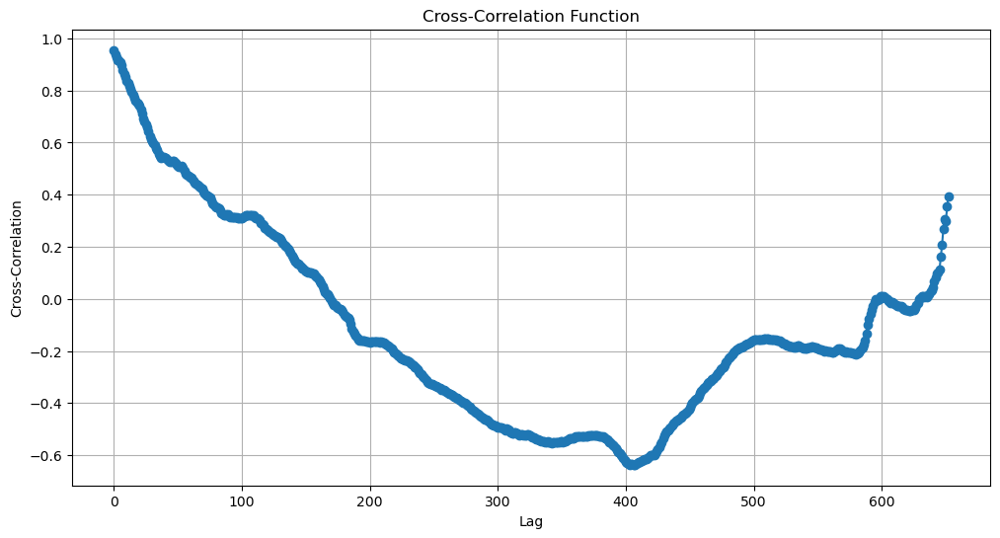

In [40]:
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt

# Assicurati che entrambe le DataFrames siano ordinate per data
elect_df = elect_df.sort_values(by='Date')
gas_df = gas_df.sort_values(by='Date')

# Unisci i due DataFrame sulle date per garantire che abbiano gli stessi giorni
merged_df = pd.merge(elect_df, gas_df, on='Date', suffixes=('_elect', '_gas'))

# Estrai le serie temporali dei prezzi
zonal_prices = merged_df['AverageZonalPrice']
gas_prices = merged_df['Prezzo']

# Calcola la cross-correlazione usando la funzione ccf di statsmodels
ccf_values = sm.tsa.stattools.ccf(gas_prices, zonal_prices)

# Tracciare la cross-correlazione
plt.figure(figsize=(12, 6))
plt.plot(ccf_values, marker='o')
plt.title('Cross-Correlation Function')
plt.xlabel('Lag')
plt.ylabel('Cross-Correlation')
plt.grid()
plt.show()

Cross-Correlation Function (CCF) obtained for the time series of electricity prices (`AverageZonalPrice`) and gas prices (`Prezzo`).

### Interpreting the CCF Graph

1. **X-Axis (Lag)**: The horizontal axis represents the lag, which is the number of time periods of delay between the two time series. A lag of 0 means we are comparing the values contemporaneously. Positive lags indicate that the gas price series is shifted forward in time relative to the electricity prices, while negative lags (not shown in the graph) would mean the gas price series is shifted backward in time.

2. **Y-Axis (Cross-Correlation)**: The vertical axis represents the cross-correlation value between the two time series. Positive values indicate a positive correlation, while negative values indicate a negative correlation.

### Results and Observations

- **Point at Lag 0**: The cross-correlation is very high (close to 1) at lag 0. This suggests a strong contemporaneous correlation between electricity prices and gas prices. When gas prices are high, electricity prices also tend to be high in the same period.

- **Decreasing Trend until Lag 400**: The cross-correlation gradually decreases as the lag increases up to around 400. This indicates that the positive correlation between the two prices decreases over time. After about 400 days, the correlation starts to become negative, suggesting that gas prices from around 400 days ago might be negatively correlated with current electricity prices.

- **Lowest Point around Lag 400**: Around a lag of 400, the cross-correlation reaches its lowest (negative) point. This might indicate a lag of around 400 days where gas prices and electricity prices have an inverse correlation.

- **Increase after Lag 400**: After lag 400, the cross-correlation begins to rise again, indicating that the relationship between the two prices starts to become positive again, although not as strong as initially.

### Temporal Pattern Interpretation

- **Contemporaneous Correlation (Lag 0)**: The strong correlation at lag 0 suggests that gas prices and electricity prices directly influence each other within the same time period.

- **Lagged Effects**: The changing correlation at various lags indicates that there might be lagged effects between the time series. The negative correlation around 400 days suggests that changes in gas prices may have a delayed and inverse effect on electricity prices.

### Conclusion

The Cross-Correlation Function provides valuable insights into the temporal relationship between gas prices and electricity prices. A strong contemporaneous correlation implies that the two markets are closely linked. The variations in lag suggest that gas prices can have both immediate and delayed effects on electricity prices, with potential inverse influences at longer delays.

For a more detailed analysis, it might be useful to apply additional statistical techniques and econometric models to better understand the dynamics between the two time series.

## other methods 

### VAR

In [41]:
from statsmodels.tsa.api import VAR

# Prepare the data for VAR
data = pd.DataFrame({'zonal_prices': zonal_prices, 'gas_prices': gas_prices})
model = VAR(data)

# Fit the model
fitted_model = model.fit(maxlags=15)

# Summary of the fitted model
print(fitted_model.summary())

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Sun, 30, Jun, 2024
Time:                     15:43:19
--------------------------------------------------------------------
No. of Equations:         2.00000    BIC:                    12.5346
Nobs:                     638.000    HQIC:                   12.2696
Log likelihood:          -5608.90    FPE:                    180147.
AIC:                      12.1014    Det(Omega_mle):         163838.
--------------------------------------------------------------------
Results for equation zonal_prices
                      coefficient       std. error           t-stat            prob
-----------------------------------------------------------------------------------
const                   14.115832         3.739493            3.775           0.000
L1.zonal_prices          0.506997         0.043394           11.684           0.000
L1.gas_prices            0.848709        

Let's evaluate the results of the Vector Autoregression (VAR) model, which captures the linear interdependencies among multiple time series. Here’s an explanation of the output and how the model works.

### Understanding the VAR Model Output

1. **Model Summary**:
   - **Number of Equations**: There are 2 equations, one for each time series (`zonal_prices` and `gas_prices`).
   - **Number of Observations (Nobs)**: 638 observations.
   - **Log Likelihood, AIC, BIC, HQIC**: These are metrics used to evaluate the model. Lower values generally indicate a better fit.

2. **Results for `zonal_prices` Equation**:
   - This section shows the coefficients, standard errors, t-statistics, and p-values for the equation predicting `zonal_prices`.

   - **const**: The constant term (intercept) for the equation.
   - **L1.zonal_prices, L1.gas_prices, ... L15.gas_prices**: These are the lagged values of `zonal_prices` and `gas_prices`. For example, `L1.zonal_prices` is the value of `zonal_prices` lagged by one period, `L2.gas_prices` is the value of `gas_prices` lagged by two periods, and so on.

   - **Key Insights**:
     - **L1.zonal_prices (0.506997, p=0.000)**: Indicates a significant positive relationship with its own first lag.
     - **L1.gas_prices (0.848709, p=0.000)**: Indicates a significant positive relationship with the first lag of `gas_prices`.
     - **L4.gas_prices (0.196305, p=0.028)**: Indicates a significant positive relationship with the fourth lag of `gas_prices`.
     - **L7.zonal_prices (0.142191, p=0.003)**: Indicates a significant positive relationship with the seventh lag of `zonal_prices`.
     - **L8.gas_prices (-0.184248, p=0.040)**: Indicates a significant negative relationship with the eighth lag of `gas_prices`.
     - **L9.zonal_prices (-0.110438, p=0.020)**: Indicates a significant negative relationship with the ninth lag of `zonal_prices`.

3. **Results for `gas_prices` Equation**:
   - This section shows the coefficients, standard errors, t-statistics, and p-values for the equation predicting `gas_prices`.

   - **Key Insights**:
     - **L1.zonal_prices (0.117774, p=0.000)**: Indicates a significant positive relationship with the first lag of `zonal_prices`.
     - **L1.gas_prices (0.634510, p=0.000)**: Indicates a significant positive relationship with its own first lag.
     - **L2.gas_prices (-0.233866, p=0.000)**: Indicates a significant negative relationship with the second lag of `gas_prices`.
     - **L3.gas_prices (0.214026, p=0.000)**: Indicates a significant positive relationship with the third lag of `gas_prices`.
     - **L5.gas_prices (0.129837, p=0.015)**: Indicates a significant positive relationship with the fifth lag of `gas_prices`.

4. **Correlation Matrix of Residuals**:
   - Shows the correlation between the residuals of the `zonal_prices` and `gas_prices` equations.
   - The correlation between the residuals is 0.358237, indicating some degree of linear relationship between the error terms of the two equations.

### How the VAR Model Works

1. **Lagged Values**:
   - The VAR model uses lagged values of the time series to predict future values. For example, `L1.zonal_prices` and `L1.gas_prices` are the values of `zonal_prices` and `gas_prices` from the previous period, respectively.
   - This allows the model to capture the dynamic relationship between the variables over time.

2. **Coefficients**:
   - Each coefficient represents the impact of a one-unit change in the corresponding lagged variable on the current value of the dependent variable.
   - Positive coefficients indicate a direct relationship, while negative coefficients indicate an inverse relationship.

3. **Significance**:
   - The p-value indicates whether the relationship between the lagged variable and the dependent variable is statistically significant. Typically, a p-value less than 0.05 indicates significance.

### Conclusion

- The results show that both `zonal_prices` and `gas_prices` have significant lagged effects on themselves and each other.
- There are significant positive and negative lagged relationships, indicating that past values of both series can influence their future values.
- This VAR model helps in understanding the temporal interdependencies between `zonal_prices` and `gas_prices`, and can be useful for forecasting future values based on past data.



### Cross-Spectral Density

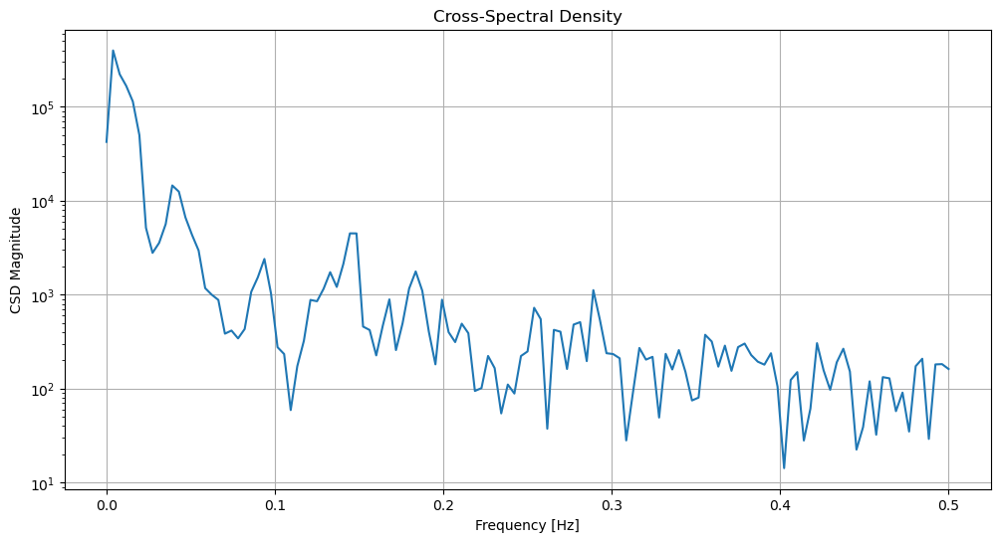

In [43]:
from scipy.signal import csd

# Calculate Cross-Spectral Density
f, Pxy = csd(zonal_prices, gas_prices, fs=1, nperseg=256)

plt.figure(figsize=(12, 6))
plt.semilogy(f, np.abs(Pxy))
plt.title('Cross-Spectral Density')
plt.xlabel('Frequency [Hz]')
plt.ylabel('CSD Magnitude')
plt.grid()
plt.show()

Let's evaluate and explain the Cross-Spectral Density (CSD) results from the graph you have provided.

### Understanding Cross-Spectral Density (CSD)

The Cross-Spectral Density (CSD) measures the strength and phase relationship between two time series as a function of frequency. It helps to understand how the two time series are related at different frequency components.

### Interpreting the CSD Graph

1. **X-Axis (Frequency)**: The horizontal axis represents the frequency in Hertz (Hz). A frequency of 0 indicates a DC component (no change over time), and higher frequencies represent faster oscillations.

2. **Y-Axis (CSD Magnitude)**: The vertical axis represents the magnitude of the cross-spectral density on a logarithmic scale. This measures the strength of the relationship between the two time series at each frequency.

### Key Observations

1. **High Magnitude at Low Frequencies**: The CSD magnitude is highest at very low frequencies (near 0 Hz). This indicates that there is a strong relationship between `zonal_prices` and `gas_prices` at low frequencies, meaning that the two time series are highly correlated in their long-term trends. Low-frequency components capture slow-moving trends and cycles.

2. **Decreasing Magnitude with Increasing Frequency**: As the frequency increases, the CSD magnitude generally decreases. This suggests that the relationship between `zonal_prices` and `gas_prices` weakens at higher frequencies. High-frequency components capture short-term fluctuations and noise.

3. **Peaks at Specific Frequencies**: There are several peaks in the CSD magnitude at specific frequencies. These peaks indicate frequencies where there is a stronger relationship between the two time series. These could correspond to periodic patterns or cycles in the data.

### Implications

- **Long-Term Trends**: The strong CSD at low frequencies implies that `zonal_prices` and `gas_prices` share common long-term trends. This could be due to underlying economic factors that affect both markets over longer periods.

- **Short-Term Fluctuations**: The weaker CSD at higher frequencies suggests that short-term fluctuations in `zonal_prices` and `gas_prices` are less synchronized. This could mean that short-term price movements are influenced by different factors in each market.

- **Periodic Patterns**: The peaks at certain frequencies may indicate periodic relationships. For instance, if there are specific frequencies corresponding to monthly or seasonal cycles, these could reflect how the two time series interact over these periods.

### Conclusion

The Cross-Spectral Density analysis provides a detailed view of how `zonal_prices` and `gas_prices` are related across different frequencies:

- There is a strong correlation in the long-term trends (low frequencies).
- The relationship weakens for short-term fluctuations (high frequencies).
- Specific periodic patterns may exist, as indicated by peaks at certain frequencies.

These insights can be useful for understanding the dynamic relationship between electricity and gas prices, guiding further analysis or modeling efforts to capture these interactions effectively. For instance, you might explore how external factors influence both markets over different time scales or use this information to improve forecasting models.

# 5. Functional Auto regressive models 

In [9]:
#load bid_df
with open('bid_df.pickle', 'rb') as f:
    bid_df = pickle.load(f)

/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/deterministic.py:302: UserWarning: Only PeriodIndexes, DatetimeIndexes with a frequency set, RangesIndexes, and Index with a unit increment support extending. The index is set will contain the position relative to the data length.
  fcast_index = self._extend_index(index, steps, forecast_index)


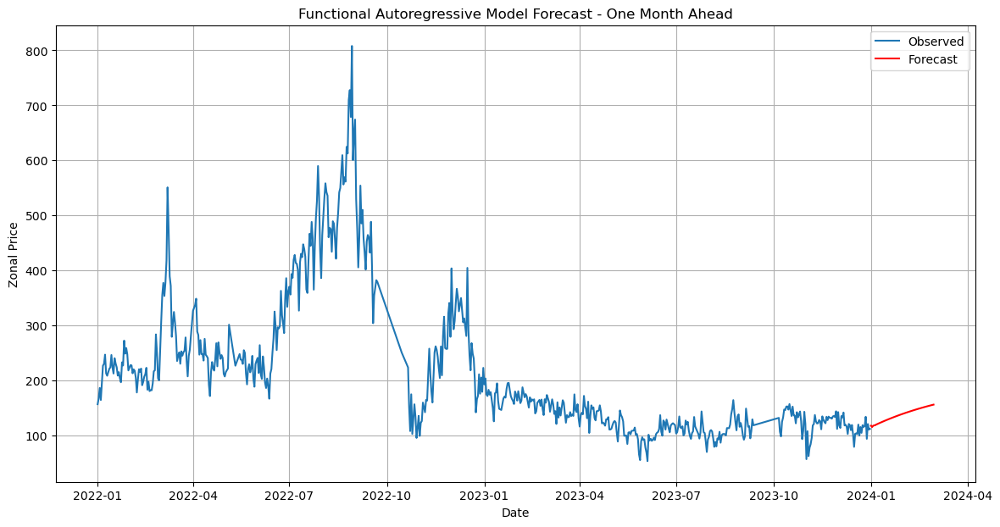

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from statsmodels.tsa.ar_model import AutoReg

# Step 1: Preprocess the data
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Day'] = bid_df['Date'].dt.date

# Aggregate the ZonalPrice by taking the mean for each day
daily_aggregated_df = bid_df.groupby(['Day']).agg({'ZonalPrice': 'mean'}).reset_index()
daily_aggregated_df['Date'] = pd.to_datetime(daily_aggregated_df['Day'])

# Step 2: Smooth the data using Univariate Spline
# Apply log transformation to ensure positivity
log_zonal_price = np.log(daily_aggregated_df['ZonalPrice'] + 1)

# Create a spline of the transformed data
days = np.arange(len(daily_aggregated_df))
spline = UnivariateSpline(days, log_zonal_price, s=0)

# Apply the inverse exponential to return to original values
smoothed_price = np.exp(spline(days)) - 1

# Store smoothed prices
smoothed_prices_df = pd.DataFrame({
    'Date': daily_aggregated_df['Date'],
    'SmoothedPrice': smoothed_price
})

# Convert to time series format
smoothed_prices_df.set_index('Date', inplace=True)
smoothed_prices_ts = smoothed_prices_df['SmoothedPrice']

# Step 3: Fit an Autoregressive (AR) model
lag_order = 7  # for daily data, this corresponds to one week
ar_model = AutoReg(smoothed_prices_ts, lags=lag_order).fit()

# Step 4: Forecast future values
forecast_steps = 60  # forecast one month ahead
forecast = ar_model.predict(start=len(smoothed_prices_ts), end=len(smoothed_prices_ts) + forecast_steps - 1)

# Create date range for forecast
last_date = smoothed_prices_ts.index[-1]
forecast_dates = pd.date_range(start=last_date, periods=forecast_steps + 1, inclusive='right')

# Plot the forecast
plt.figure(figsize=(14, 7))
plt.plot(smoothed_prices_ts.index, smoothed_prices_ts, label='Observed')
plt.plot(forecast_dates, forecast, label='Forecast', color='red')
plt.xlabel('Date')
plt.ylabel('Zonal Price')
plt.title('Functional Autoregressive Model Forecast - One Month Ahead')
plt.legend()
plt.grid(True)
plt.show()

/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/deterministic.py:302: UserWarning: Only PeriodIndexes, DatetimeIndexes with a frequency set, RangesIndexes, and Index with a unit increment support extending. The index is set will contain the position relative to the data length.
  fcast_index = self._extend_index(index, steps, forecast_index)


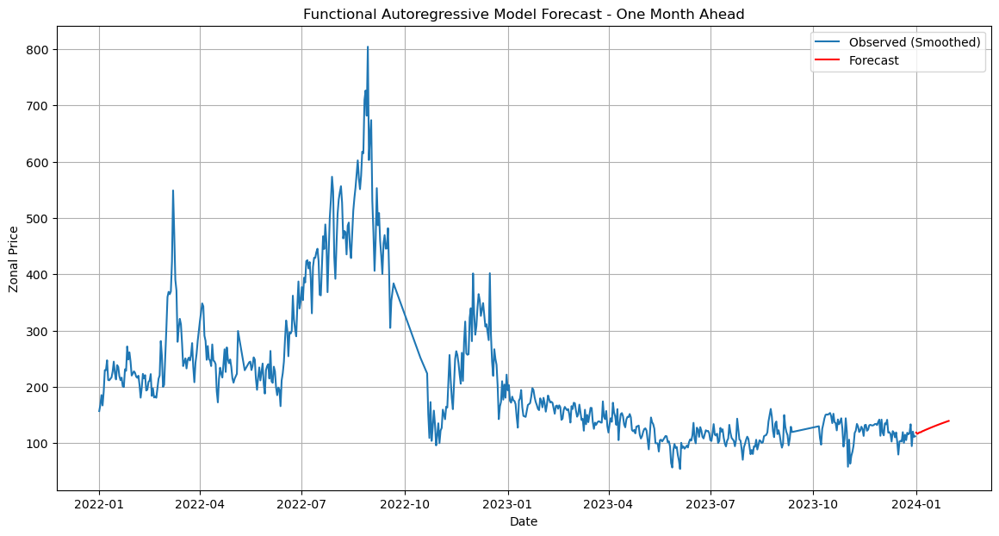

In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from statsmodels.tsa.ar_model import AutoReg

# Step 1: Preprocess the data
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Day'] = bid_df['Date'].dt.date

# Aggregate the ZonalPrice by taking the mean for each day
daily_aggregated_df = bid_df.groupby(['Day']).agg({'ZonalPrice': 'mean'}).reset_index()
daily_aggregated_df['Date'] = pd.to_datetime(daily_aggregated_df['Day'])

# Step 2: Smooth the data using Univariate Spline
# Apply log transformation to ensure positivity
log_zonal_price = np.log(daily_aggregated_df['ZonalPrice'] + 1)

# Create a spline of the transformed data
days = np.arange(len(daily_aggregated_df))
spline = UnivariateSpline(days, log_zonal_price, s=0.1)

# Apply the inverse exponential to return to original values
smoothed_price = np.exp(spline(days)) - 1

# Store smoothed prices
smoothed_prices_df = pd.DataFrame({
    'Date': daily_aggregated_df['Date'],
    'SmoothedPrice': smoothed_price
})

# Convert to time series format
smoothed_prices_df.set_index('Date', inplace=True)
smoothed_prices_ts = smoothed_prices_df['SmoothedPrice']

# Step 3: Fit an Autoregressive (AR) model
lag_order = 7  # for daily data, this corresponds to one week
ar_model = AutoReg(smoothed_prices_ts, lags=lag_order).fit()

# Step 4: Forecast future values
forecast_steps = 30  # forecast one month ahead
forecast = ar_model.predict(start=len(smoothed_prices_ts), end=len(smoothed_prices_ts) + forecast_steps - 1)

# Create date range for forecast
last_date = smoothed_prices_ts.index[-1]
forecast_dates = pd.date_range(start=last_date, periods=forecast_steps + 1, inclusive='right')

# Plot the forecast
plt.figure(figsize=(14, 7))
plt.plot(smoothed_prices_ts.index, smoothed_prices_ts, label='Observed (Smoothed)')
plt.plot(forecast_dates, forecast, label='Forecast', color='red')
plt.xlabel('Date')
plt.ylabel('Zonal Price')
plt.title('Functional Autoregressive Model Forecast - One Month Ahead')
plt.legend()
plt.grid(True)
plt.show()

/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


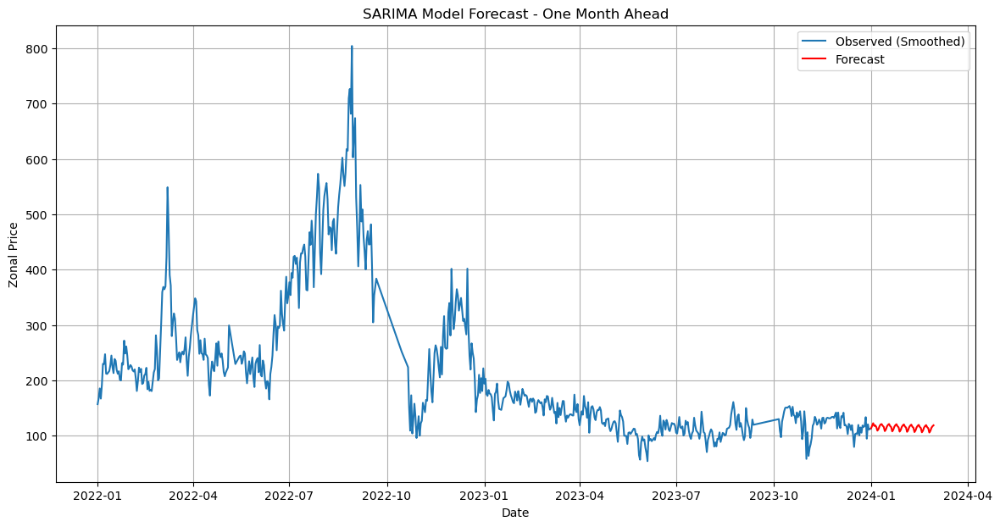

In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Step 1: Preprocess the data
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Day'] = bid_df['Date'].dt.date

# Aggregate the ZonalPrice by taking the mean for each day
daily_aggregated_df = bid_df.groupby(['Day']).agg({'ZonalPrice': 'mean'}).reset_index()
daily_aggregated_df['Date'] = pd.to_datetime(daily_aggregated_df['Day'])

# Step 2: Smooth the data using Univariate Spline with lambda=0.1
# Apply log transformation to ensure positivity
log_zonal_price = np.log(daily_aggregated_df['ZonalPrice'] + 1)

# Create a spline of the transformed data with smoothing factor
days = np.arange(len(daily_aggregated_df))
spline = UnivariateSpline(days, log_zonal_price, s=0.1)

# Apply the inverse exponential to return to original values
smoothed_price = np.exp(spline(days)) - 1

# Store smoothed prices
smoothed_prices_df = pd.DataFrame({
    'Date': daily_aggregated_df['Date'],
    'SmoothedPrice': smoothed_price
})

# Convert to time series format
smoothed_prices_df.set_index('Date', inplace=True)
smoothed_prices_ts = smoothed_prices_df['SmoothedPrice']

# Step 3: Fit a SARIMA model
# SARIMA parameters (p, d, q, P, D, Q, s)
order = (1, 1, 1)
seasonal_order = (1, 1, 1, 7)
sarima_model = SARIMAX(smoothed_prices_ts, order=order, seasonal_order=seasonal_order).fit(disp=False)

# Step 4: Forecast future values
forecast_steps = 60  # forecast one month ahead
forecast = sarima_model.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=smoothed_prices_ts.index[-1], periods=forecast_steps + 1, inclusive='right')

# Plot the forecast
plt.figure(figsize=(14, 7))
plt.plot(smoothed_prices_ts.index, smoothed_prices_ts, label='Observed (Smoothed)')
plt.plot(forecast_index, forecast.predicted_mean, label='Forecast', color='red')
plt.xlabel('Date')
plt.ylabel('Zonal Price')
plt.title('SARIMA Model Forecast - One Month Ahead')
plt.legend()
plt.grid(True)
plt.show()

/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-packages/statsmodels/tsa/deterministic.py:302: UserWarning: Only PeriodIndexes, DatetimeIndexes with a frequency set, RangesIndexes, and Index with a unit increment support extending. The index is set will contain the position relative to the data length.
  fcast_index = self._extend_index(index, steps, forecast_index)
/Users/luca.distefano/opt/anaconda3/envs/as/lib/python3.11/site-p

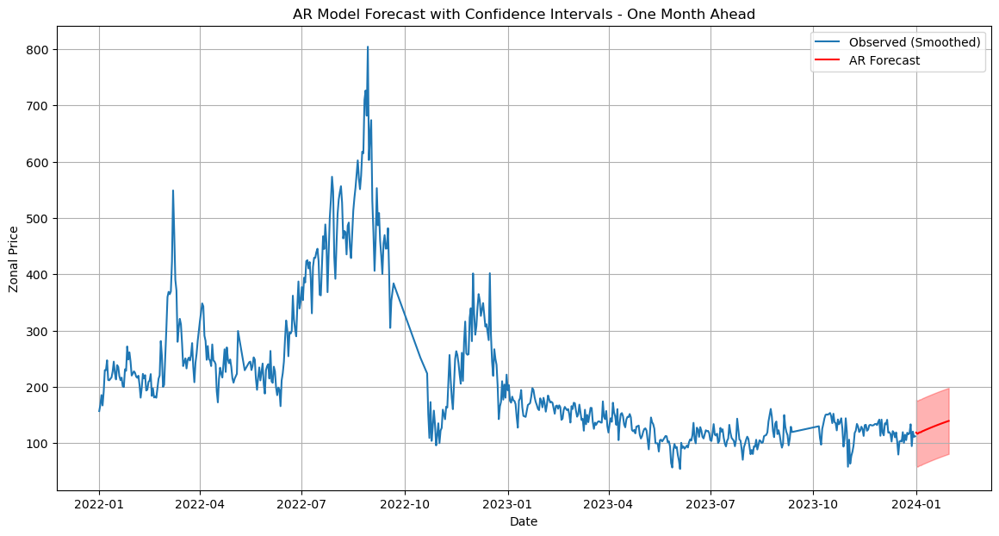

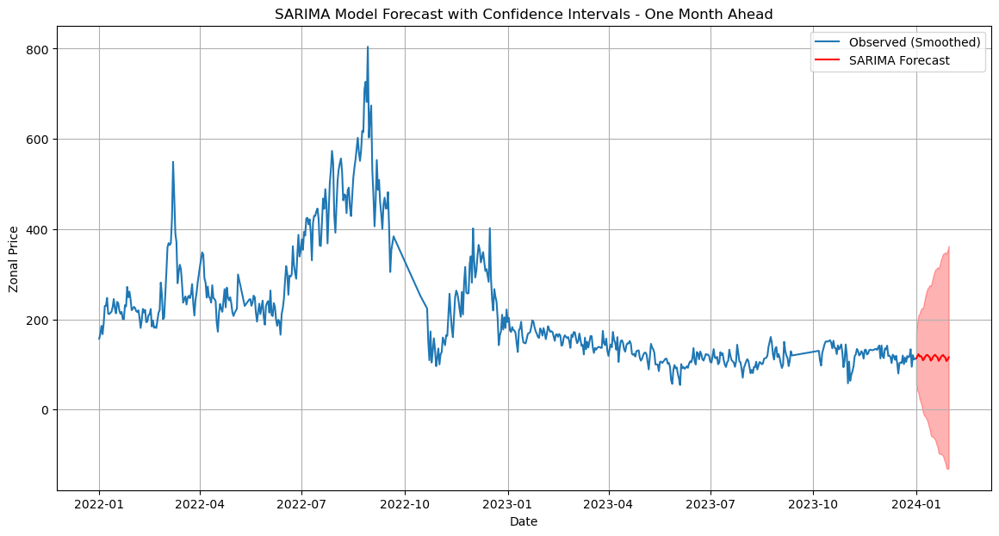

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Step 1: Preprocess the data
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Day'] = bid_df['Date'].dt.date

# Aggregate the ZonalPrice by taking the mean for each day
daily_aggregated_df = bid_df.groupby(['Day']).agg({'ZonalPrice': 'mean'}).reset_index()
daily_aggregated_df['Date'] = pd.to_datetime(daily_aggregated_df['Day'])

# Step 2: Smooth the data using Univariate Spline with lambda=0.1
# Apply log transformation to ensure positivity
log_zonal_price = np.log(daily_aggregated_df['ZonalPrice'] + 1)

# Create a spline of the transformed data with smoothing factor
days = np.arange(len(daily_aggregated_df))
spline = UnivariateSpline(days, log_zonal_price, s=0.1)

# Apply the inverse exponential to return to original values
smoothed_price = np.exp(spline(days)) - 1

# Store smoothed prices
smoothed_prices_df = pd.DataFrame({
    'Date': daily_aggregated_df['Date'],
    'SmoothedPrice': smoothed_price
})

# Convert to time series format
smoothed_prices_df.set_index('Date', inplace=True)
smoothed_prices_ts = smoothed_prices_df['SmoothedPrice']

# AR Model
# Step 3: Fit an Autoregressive (AR) model
lag_order = 7  # for daily data, this corresponds to one week
ar_model = AutoReg(smoothed_prices_ts, lags=lag_order).fit()

# Step 4: Forecast future values
forecast_steps = 30  # forecast one month ahead
forecast_ar = ar_model.predict(start=len(smoothed_prices_ts), end=len(smoothed_prices_ts) + forecast_steps - 1)

# Calculate confidence intervals for AR forecast
forecast_ar_se = np.sqrt(ar_model.sigma2)
forecast_ar_conf_int = pd.DataFrame({
    'lower': forecast_ar - 1.96 * forecast_ar_se,
    'upper': forecast_ar + 1.96 * forecast_ar_se
})

# Create date range for forecast
last_date = smoothed_prices_ts.index[-1]
forecast_ar_dates = pd.date_range(start=last_date, periods=forecast_steps + 1, inclusive='right')

# SARIMA Model
# Step 3: Fit a SARIMA model
order = (1, 1, 1)
seasonal_order = (1, 1, 1, 7)
sarima_model = SARIMAX(smoothed_prices_ts, order=order, seasonal_order=seasonal_order).fit(disp=False)

# Step 4: Forecast future values
forecast_sarima = sarima_model.get_forecast(steps=forecast_steps)
forecast_sarima_index = pd.date_range(start=smoothed_prices_ts.index[-1], periods=forecast_steps + 1, inclusive='right')
forecast_sarima_ci = forecast_sarima.conf_int()

# Plot the AR model forecast with confidence intervals
plt.figure(figsize=(14, 7))
plt.plot(smoothed_prices_ts.index, smoothed_prices_ts, label='Observed (Smoothed)')
plt.plot(forecast_ar_dates, forecast_ar, label='AR Forecast', color='red')
plt.fill_between(forecast_ar_dates, forecast_ar_conf_int['lower'], forecast_ar_conf_int['upper'], color='red', alpha=0.3)
plt.xlabel('Date')
plt.ylabel('Zonal Price')
plt.title('AR Model Forecast with Confidence Intervals - One Month Ahead')
plt.legend()
plt.grid(True)
plt.show()

# Plot the SARIMA model forecast with confidence intervals
plt.figure(figsize=(14, 7))
plt.plot(smoothed_prices_ts.index, smoothed_prices_ts, label='Observed (Smoothed)')
plt.plot(forecast_sarima_index, forecast_sarima.predicted_mean, label='SARIMA Forecast', color='red')
plt.fill_between(forecast_sarima_index, forecast_sarima_ci.iloc[:, 0], forecast_sarima_ci.iloc[:, 1], color='red', alpha=0.3)
plt.xlabel('Date')
plt.ylabel('Zonal Price')
plt.title('SARIMA Model Forecast with Confidence Intervals - One Month Ahead')
plt.legend()
plt.grid(True)
plt.show()

In [23]:
pip install prophet

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.2/8.2 MB 11.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.5/94.5 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 14.4 MB/s eta 0:00:00a 0:00:01

[notice] A new release of pip is available: 24.0 -> 24.1.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


12:13:57 - cmdstanpy - INFO - Chain [1] start processing
12:13:57 - cmdstanpy - INFO - Chain [1] done processing


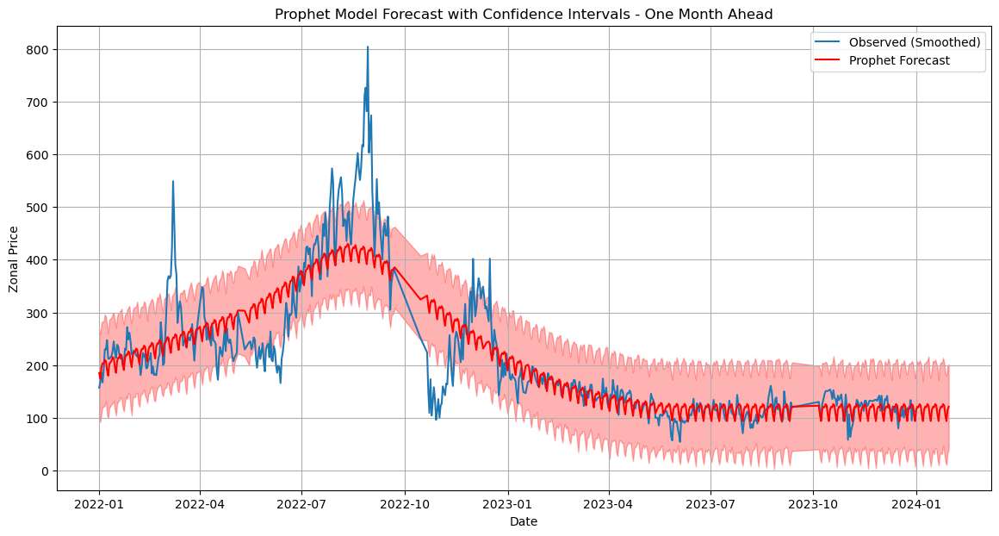

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import UnivariateSpline
from prophet import Prophet

# Step 1: Preprocess the data
bid_df['Date'] = pd.to_datetime(bid_df['Date'])
bid_df['Day'] = bid_df['Date'].dt.date

# Aggregate the ZonalPrice by taking the mean for each day
daily_aggregated_df = bid_df.groupby(['Day']).agg({'ZonalPrice': 'mean'}).reset_index()
daily_aggregated_df['Date'] = pd.to_datetime(daily_aggregated_df['Day'])

# Step 2: Smooth the data using Univariate Spline with lambda=0.1
# Apply log transformation to ensure positivity
log_zonal_price = np.log(daily_aggregated_df['ZonalPrice'] + 1)

# Create a spline of the transformed data with smoothing factor
days = np.arange(len(daily_aggregated_df))
spline = UnivariateSpline(days, log_zonal_price, s=0.1)

# Apply the inverse exponential to return to original values
smoothed_price = np.exp(spline(days)) - 1

# Prepare data for Prophet
prophet_df = pd.DataFrame({
    'ds': daily_aggregated_df['Date'],
    'y': smoothed_price
})

# Step 3: Fit a Prophet model
model = Prophet()
model.fit(prophet_df)

# Step 4: Forecast future values
future = model.make_future_dataframe(periods=30)  # forecast one month ahead
forecast = model.predict(future)

# Plot the forecast
fig, ax = plt.subplots(figsize=(14, 7))
ax.plot(prophet_df['ds'], prophet_df['y'], label='Observed (Smoothed)')
ax.plot(forecast['ds'], forecast['yhat'], label='Prophet Forecast', color='red')
ax.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], color='red', alpha=0.3)
ax.set_xlabel('Date')
ax.set_ylabel('Zonal Price')
ax.set_title('Prophet Model Forecast with Confidence Intervals - One Month Ahead')
ax.legend()
ax.grid(True)
plt.show()